# Assignment 2 Music Generation

## Task 1: Symbolic Unconditioned Generation

### Train a RNN LSTM on 4 melodies (p(x)) and sample new sequences.

### Installation & Imports

In [ ]:
# Install required libraries
# !pip install torch pretty_midi matplotlib midi2audio librosa

  Using cached midi2audio-0.1.1-py2.py3-none-any.whl.metadata (5.7 kB)
  Using cached librosa-0.11.0-py3-none-any.whl.metadata (8.7 kB)
  Using cached cycler-0.12.1-py3-none-any.whl.metadata (3.8 kB)
  Using cached pyparsing-3.2.3-py3-none-any.whl.metadata (5.0 kB)
  Using cached audioread-3.0.1-py3-none-any.whl.metadata (8.4 kB)
  Using cached soundfile-0.13.1-py2.py3-none-macosx_11_0_arm64.whl.metadata (16 kB)
  Using cached pooch-1.8.2-py3-none-any.whl.metadata (10 kB)
  Using cached soxr-0.5.0.post1-cp312-abi3-macosx_11_0_arm64.whl.metadata (5.6 kB)
  Using cached lazy_loader-0.4-py3-none-any.whl.metadata (7.6 kB)
  Using cached requests-2.32.3-py3-none-any.whl.metadata (4.6 kB)
  Using cached idna-3.10-py3-none-any.whl.metadata (10 kB)
  Using cached urllib3-2.4.0-py3-none-any.whl.metadata (6.5 kB)
  Using cached threadpoolctl-3.6.0-py3-none-any.whl.metadata (13 kB)
  Using cached pycparser-2.22-py3-none-any.whl.metadata (943 bytes)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.1/

In [8]:
# Imports
import os
import torch
import torch.nn as nn
import torch.optim as optim
import numpy as np
import random
import pretty_midi
import matplotlib.pyplot as plt
import pickle
import torch.nn.functional as F
import librosa
import collections
import math

from torch.utils.data import Dataset, DataLoader
from midi2audio import FluidSynth
from IPython.display import Audio, display
from matplotlib.ticker import MaxNLocator

### Data Loading

In [3]:
# Load the pre‐serialized JSB Chorales dataset
with open("JSB-Chorales-dataset-master/jsb-chorales-quarter.pkl", "rb") as f:
    data = pickle.load(f, encoding="latin1")

# We’ll work with the training split here, you can also access 'valid' and 'test'
chorales = data["train"]
print(f"Loaded {len(chorales)} training chorales.")
print("Sample:", chorales[0][:5])

Loaded 229 training chorales.
Sample: [(60, 72, 79, 88), (72, 79, 88), (67, 70, 76, 84), (69, 77, 86), (67, 70, 79, 88)]



### Dataset Context
The JSB Chorales dataset consists of 382 four-part harmonized chorales by J.S. Bach. It is widely used in symbolic music modeling and has been curated to support machine learning tasks. We use the version released by [Zhuang et al.](https://github.com/czhuang/JSB-Chorales-dataset), which is represented as a sequence of four‐voice chord events (soprano, alto, tenor, bass), quantized to quarter‐note durations. 

Instead of modeling only the soprano line, we now build a **polyphonic** model that learns full four‐voice chorales in parallel. At each time step, the model will predict an entire 4‐tuple of MIDI pitches (or rests) for all voices simultaneously.

### Preprocessing Steps

1. **Extract four‐voice chord tuples**  
   - For each chorale, read each 4‐element chord event (one MIDI pitch per voice).  
   - Skip any chord where all four voices are rests (`-1, -1, -1, -1`).  
   - Drop any chorale that has fewer than 10 valid chords.

2. **Build a chord vocabulary**  
   - Collect the set of all unique 4‐tuples (soprano, alto, tenor, bass) across the training split.  
   - Map each unique chord‐tuple to a distinct integer index.

3. **Tokenize each chorale as a sequence of chord‐indices**  
   - Convert each 4‐tuple in a chorale to its index in the chord vocabulary.  
   - Discard any chord not found in the vocabulary (e.g., if it only appeared in validation/test).

4. **Prepare sequence‐to‐sequence training pairs**  
   - Slide a fixed‐length window (e.g., 32 chords) over each tokenized chord sequence.  
   - For each window, the input is the first 32 chord‐indices, and the target is the next 32 chord‐indices (shifted by one).

5. **Build `ChordSequenceDataset` and `DataLoader`**  
   - Wrap the tokenized sequences of indices in a PyTorch `Dataset` that returns `(input_seq, target_seq)` pairs.  
   - Use a `DataLoader` with a suitable batch size (e.g., 64) to feed the LSTM.

After these steps, we feed full four‐voice chord sequences into our `MusicRNN` model so that at each step it learns to predict a 4‐voice chord rather than a single monophonic melody.

In [ ]:
# We build a sequence of 4‐tuples for all 4 harmonies: soprano, alto, tenor, bass.
# We skip any chord that is all rests (-1 in every voice), and drop very short chorales.
chord_seqs = []

for chorale in chorales:
    chord_list = []
    for chord in chorale:
        # Chord is either a list/tuple of length 4, or -1 for a complete rest
        if isinstance(chord, (list, tuple)) and len(chord) == 4:
            # Convert any numpy types to int and keep the 4‐tuple as is:
            chord_tuple = (int(chord[0]), int(chord[1]), int(chord[2]), int(chord[3]))
            # If the chord is NOT four rests, we keep it.  (If all four voices are -1, skip.)
            if chord_tuple != (-1, -1, -1, -1):
                chord_list.append(chord_tuple)
    # Only keep chorales longer than 10 chords
    if len(chord_list) > 10:
        chord_seqs.append(chord_list)

print(f"Extracted {len(chord_seqs)} four‐voice sequences.")
print("Example chord‐sequence (first 5 chords):", chord_seqs[0][:5])

Extracted 229 four‐voice sequences.
Example chord‐sequence (first 5 chords): [(60, 72, 79, 88), (67, 70, 76, 84), (67, 70, 79, 88), (65, 72, 81, 89), (65, 72, 81, 89)]


### Vocabulary & Tokenization

In [ ]:
# Build a set of all unique 4‐tuples (chords) in the training split.

all_chords = sorted({tuple(chord) for seq in chord_seqs for chord in seq})
# Map each chord‐tuple to a unique integer index
chord_to_idx = {chord: i for i, chord in enumerate(all_chords)}
idx_to_chord = {i: chord for chord, i in chord_to_idx.items()}
vocab_size = len(chord_to_idx)

# Convert each chord‐tuple sequence into a list of indices
tokenized_chord_seqs = [[chord_to_idx[ch] for ch in seq] for seq in chord_seqs]

print("Four‐voice chord vocabulary size:", vocab_size)
print("Tokenized example (first 10 chord‐indices):", tokenized_chord_seqs[0][:10])

Four‐voice chord vocabulary size: 2113
Tokenized example (first 10 chord‐indices): [736, 1496, 1502, 1338, 1338, 537, 1697, 1634, 1704, 1445]


### Dataset Class

In [ ]:
# Create Dataset class for LSTM training. 
# Takes tokenized melody sequences and splits into
# fixed-length input-output pairs.
class ChordSequenceDataset(Dataset):
    def __init__(self, token_chord_seqs, seq_len=32):
        super().__init__()
        self.samples = []
        # Slide a window of length seq_len over each chord‐token sequence
        for seq in token_chord_seqs:
            for i in range(len(seq) - seq_len):
                x = seq[i : i + seq_len]           # input: a sequence of chord‐indices
                y = seq[i + 1 : i + seq_len + 1]   # target: next‐chord at each step
                self.samples.append((x, y))

    def __len__(self):
        return len(self.samples)

    def __getitem__(self, idx):
        x, y = self.samples[idx]
        # Return LongTensors of shape (seq_len,) of chord‐indices
        return torch.tensor(x, dtype=torch.long), \
               torch.tensor(y, dtype=torch.long)

### DataLoader Preparation

In [ ]:
# Create batches of (input, target) pairs for training.
seq_len  = 32 # length of each input sequence (tries to predict 32 next notes)
batch_size = 64 # number of sequences per batch (process 64 input-output pairs at a time)

# Create dataset and dataloader
dataset = ChordSequenceDataset(tokenized_chord_seqs, seq_len=seq_len)
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)
print(f"Total training chord‐sequences: {len(dataset)}")

Total training chord‐sequences: 5186


### Training Model

In [ ]:
class MusicRNN(nn.Module):
    def __init__(self, vocab_size, embedding_dim=128, hidden_dim=256, num_layers=2, seq_len=32):
        super(MusicRNN, self).__init__()
        # Embedding now maps each chord‐index to a dense vector
        self.embedding      = nn.Embedding(vocab_size, embedding_dim)
        # Positional embeddings add information about each timestep's position
        self.position_embed = nn.Embedding(seq_len, embedding_dim)

         # LSTM stack: processes the embedded sequence, with dropout between layers
        self.lstm = nn.LSTM(
            input_size=embedding_dim,
            hidden_size=hidden_dim,
            num_layers=num_layers,
            batch_first=True, # input/output tensors have shape (batch, seq, feature)
            dropout=0.2 # dropout on outputs of all layers except the last
        )

        self.norm    = nn.LayerNorm(hidden_dim) # LayerNorm stabilizes the activations before the final layers
        self.dropout = nn.Dropout(0.3) # Dropout after LSTM to reduce overfitting
        self.fc      = nn.Linear(hidden_dim, vocab_size) # Final linear layer maps hidden states to vocabulary logits

    def forward(self, x):
        batch_size, seqlen = x.size()
        # Create a tensor of positions [0, 1, ..., seq_len-1] for each example
        positions = (torch.arange(seqlen, device=x.device)
                        .unsqueeze(0)
                        .expand(batch_size, seqlen))
        embeddings = self.embedding(x) + self.position_embed(positions)

        out, _     = self.lstm(embeddings)
        out        = self.norm(out)
        out        = self.dropout(out)
        
        logits     = self.fc(out)  # shape: (batch_size, seqlen, vocab_size)
        return logits

In [9]:
def train_rnn(model, dataloader, vocab_size, num_epochs=10, lr=0.001,
              device="cuda" if torch.cuda.is_available() else "cpu"):
    """
    Train the MusicRNN on the provided dataloader.

    model: instance of MusicRNN
    dataloader: yields (input_batch, target_batch) pairs
    vocab_size: size of the token vocabulary for loss calculation
    """
    model     = model.to(device)
    optimizer = optim.Adam(model.parameters(), lr=lr)
    loss_fn   = nn.CrossEntropyLoss()
    # Scheduler reduces LR by 0.5 if validation loss hasn't improved for 2 epochs
    scheduler = optim.lr_scheduler.ReduceLROnPlateau(
                    optimizer, mode="min", factor=0.5, patience=2)

    for epoch in range(num_epochs):
        model.train()
        total_loss = 0.0

        for xb, yb in dataloader:
            xb, yb = xb.to(device), yb.to(device)
            optimizer.zero_grad()

            # Forward pass: get logits of shape (batch, seq_len, vocab_size)
            logits = model(xb)

            # Compute cross-entropy loss across all timesteps
            loss = loss_fn(
                logits.view(-1, vocab_size),   # (batch*seq_len, vocab_size)
                yb.view(-1)                     # (batch*seq_len,)
            )

            # Backward pass and gradient clipping
            loss.backward()
            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)

            # Update model parameters
            optimizer.step()
            total_loss += loss.item()

        avg_loss = total_loss / len(dataloader)
        print(f"Epoch {epoch+1}/{num_epochs} | Loss: {avg_loss:.4f}")

        # Step the scheduler with the average training loss
        scheduler.step(avg_loss)

In [10]:
# Trains the Model for 10 epochs
model = MusicRNN(vocab_size=vocab_size, seq_len=32)
train_rnn(model, dataloader, vocab_size, num_epochs=10)

Epoch 1/10 | Loss: 5.1666
Epoch 2/10 | Loss: 2.5353
Epoch 3/10 | Loss: 1.3446
Epoch 4/10 | Loss: 0.8037
Epoch 5/10 | Loss: 0.5484
Epoch 6/10 | Loss: 0.4196
Epoch 7/10 | Loss: 0.3458
Epoch 8/10 | Loss: 0.2947
Epoch 9/10 | Loss: 0.2619
Epoch 10/10 | Loss: 0.2408


### Sampling from the trained LSTM

In [ ]:
# 3 samples: (A) a random 4-note prefix, (B) a single-note "cold" start, or (C) a very short seed.

def sample_diverse(
    model,
    tokenized_seqs,
    max_length=64,
    prefix_type="random_short",  # "random_short", "single", or "fixed"
    fixed_prefix=None,           # only used if prefix_type=="fixed"
    prefix_len=4, 
    first_steps_temp=2.0,        # high temp for initial steps
    normal_temp=1.0,
    top_k=5,
    top_p=0.8,
    device="cuda" if torch.cuda.is_available() else "cpu"
):
    """
    prefix_type:
      - "fixed": uses fixed_prefix (list of IDs)
      - "random_short": picks a random melody and takes prefix_len tokens
      - "single": starts from 1 random token
    """
    model.eval().to(device)
    
    # Pick our seed
    if prefix_type == "fixed":
        assert fixed_prefix is not None
        prefix = fixed_prefix
    elif prefix_type == "random_short":
        seq = random.choice(tokenized_seqs)
        prefix = seq[:prefix_len]
    elif prefix_type == "single":
        prefix = [ random.choice(tokenized_seqs)[0] ]
    else:
        raise ValueError("bad prefix_type")

    generated = prefix[:]
    input_seq = torch.tensor([generated], device=device)
    
    def filter_logits(logits):
        from torch.nn.functional import softmax
        logits = logits.clone()
        # Top-k
        if top_k>0:
            kth = torch.topk(logits, top_k)[0][-1]
            logits[logits <  kth] = -1e9
        # Top-p
        if top_p>0:
            sorted_logits, sorted_idx = torch.sort(logits, descending=True)
            cum = softmax(sorted_logits, dim=-1).cumsum(dim=-1)
            mask = cum > top_p
            mask[...,1:] = mask[...,:-1].clone()
            mask[...,0]  = False
            logits[ sorted_idx[mask] ] = -1e9
        return logits

    for i in range(max_length - len(prefix)):
        # Choose temperature
        temp = first_steps_temp if i < len(prefix) else normal_temp
        
        seq_len = model.position_embed.num_embeddings
        inp = input_seq[:, -seq_len:]
        logits = model(inp)[0, -1, :] / temp
        filt   = filter_logits(logits)
        probs  = F.softmax(filt, dim=-1)
        nxt    = torch.multinomial(probs, 1).item()

        generated.append(nxt)
        input_seq = torch.tensor([generated], device=device)

    return generated

# Try all three strategies:
gens = {}
gens["A_random4"] = sample_diverse(
    model,
    tokenized_chord_seqs,       
    prefix_type="random_short",
    prefix_len=4
)
gens["B_single"] = sample_diverse(
    model,
    tokenized_chord_seqs,
    prefix_type="single"
)
gens["C_fixed4"] = sample_diverse(
    model,
    tokenized_chord_seqs,
    prefix_type="fixed",
    fixed_prefix=tokenized_chord_seqs[0][:4]  # first 4 chords of the first chorale
)

# Now map each generated chord-index sequence back to actual 4-tuples
chord_sequences = {
    name: [idx_to_chord[idx] for idx in seq]
    for name, seq in gens.items()
}

# 3 different generated strategies
generated_chords   = chord_sequences["A_random4"]
generated_chords2  = chord_sequences["B_single"]
generated_chords3  = chord_sequences["C_fixed4"]

### Save original & generated as MIDI and convert to WAV for listening

In [ ]:
# Helper function to write a list of MIDI pitches to a .mid file
# with all four voice‐notes in parallel at each time step.
def save_four_voice_midi(chord_seq, filename="polyphonic_output.mid", note_duration=0.5):
    pm = pretty_midi.PrettyMIDI()
    instr = pretty_midi.Instrument(program=0)  # single piano instrument
    current_time = 0.0

    for item in chord_seq:
        if isinstance(item, tuple):
            chord_tuple = item
        else:
            # assume 'item' is an index
            chord_tuple = idx_to_chord[item]

        for pitch in chord_tuple:
            if pitch != -1:
                note = pretty_midi.Note(
                    velocity=100,
                    pitch=pitch,
                    start=current_time,
                    end=current_time + note_duration
                )
                instr.notes.append(note)

        current_time += note_duration

    pm.instruments.append(instr)
    pm.write(filename)

In [ ]:
# Convert chord-indices → write a four-voice MIDI
save_four_voice_midi(generated_chords,  filename="generated_chords_A.mid")
save_four_voice_midi(generated_chords2, filename="generated_chords_B.mid")
save_four_voice_midi(generated_chords3, filename="generated_chords_C.mid")

# Convert original 4-voice (first 64 chords) and each generated version to WAV
save_four_voice_midi(tokenized_chord_seqs[0][:64], filename="original_chords.mid")
fs = FluidSynth("FluidR3_GM.sf2")
fs.midi_to_audio("original_chords.mid",      "original_chords.wav")
fs.midi_to_audio("generated_chords_A.mid",   "generated_A.wav")
fs.midi_to_audio("generated_chords_B.mid",   "generated_B.wav")
fs.midi_to_audio("generated_chords_C.mid",   "generated_C.wav")

# Play back and display audio in notebook
print("🎹 Original four-voice:")
display(Audio("original_chords.wav"))

print("🎹 Generated (A: random4):")
display(Audio("generated_A.wav"))

print("🎹 Generated (B: single-chord cold start):")
display(Audio("generated_B.wav"))

print("🎹 Generated (C: fixed4 prefix):")
display(Audio("generated_C.wav"))

FluidSynth runtime version 2.3.5
Copyright (C) 2000-2024 Peter Hanappe and others.
Distributed under the LGPL license.
SoundFont(R) is a registered trademark of Creative Technology Ltd.

Rendering audio to file 'original_chords.wav'..
FluidSynth runtime version 2.3.5
Copyright (C) 2000-2024 Peter Hanappe and others.
Distributed under the LGPL license.
SoundFont(R) is a registered trademark of Creative Technology Ltd.

Rendering audio to file 'generated_A.wav'..
FluidSynth runtime version 2.3.5
Copyright (C) 2000-2024 Peter Hanappe and others.
Distributed under the LGPL license.
SoundFont(R) is a registered trademark of Creative Technology Ltd.

Rendering audio to file 'generated_B.wav'..
FluidSynth runtime version 2.3.5
Copyright (C) 2000-2024 Peter Hanappe and others.
Distributed under the LGPL license.
SoundFont(R) is a registered trademark of Creative Technology Ltd.

Rendering audio to file 'generated_C.wav'..
🎹 Original four-voice:


🎹 Generated (A: random4):


🎹 Generated (B: single-chord cold start):


🎹 Generated (C: fixed4 prefix):


### Extract pitches back from files for plotting

In [ ]:
def extract_midi_pitches(midi_file):
    """Load MIDI and return a list of (start_time, pitch) sorted by time."""
    midi_data = pretty_midi.PrettyMIDI(midi_file)
    pitches = []
    for note in midi_data.instruments[0].notes:
        pitches.append((note.start, note.pitch))
    # Sort by start time and return pitch only
    pitches.sort()
    
    return [p[1] for p in pitches]

def extract_pitch_from_wav(wav_file):
    """Use librosa’s pitch tracker to extract a MIDI‐rounded pitch contour."""
    y, sr = librosa.load(wav_file)
    pitches, magnitudes = librosa.piptrack(y=y, sr=sr)
    pitch_track = []
    for i in range(pitches.shape[1]):
        index = magnitudes[:, i].argmax()
        pitch = pitches[index, i]
        pitch_track.append(pitch if pitch > 0 else np.nan)
    # Convert Hz to MIDI pitch (round)
    midi_pitches = [int(round(librosa.hz_to_midi(p))) if not np.isnan(p) else np.nan for p in pitch_track]
    return midi_pitches

def plot_waveform(wav_file, ax, title="Waveform"):
    """Load a WAV file and plot its waveform on the given Axes."""
    y, sr = librosa.load(wav_file, sr=None)  # preserve native sample rate
    times = np.arange(len(y)) / sr
    ax.plot(times, y, linewidth=0.5)
    ax.set_title(title)
    ax.set_xlabel("Time (s)")
    ax.set_ylabel("Amplitude")
    ax.grid(True, linestyle='--', alpha=0.5)

def plot_spectrogram(wav_file, ax, title="Spectrogram"):
    """Load a WAV file and plot its log-power spectrogram on the given Axes."""
    y, sr = librosa.load(wav_file, sr=None)
    # Compute short-time Fourier transform
    D = librosa.stft(y, n_fft=1024, hop_length=512)
    # Convert to decibels
    S_db = librosa.amplitude_to_db(np.abs(D), ref=np.max)
    img = librosa.display.specshow(
        S_db,
        sr=sr,
        hop_length=512,
        x_axis='time',
        y_axis='hz',
        ax=ax
    )
    ax.set_title(title)
    ax.set_xlabel("Time (s)")
    ax.set_ylabel("Frequency (Hz)")
    # Add a colorbar on the right of this axis
    plt.colorbar(img, ax=ax, format="%+2.0f dB")

### Compare Original vs Generated A (random4): Waveform & Spectrogram

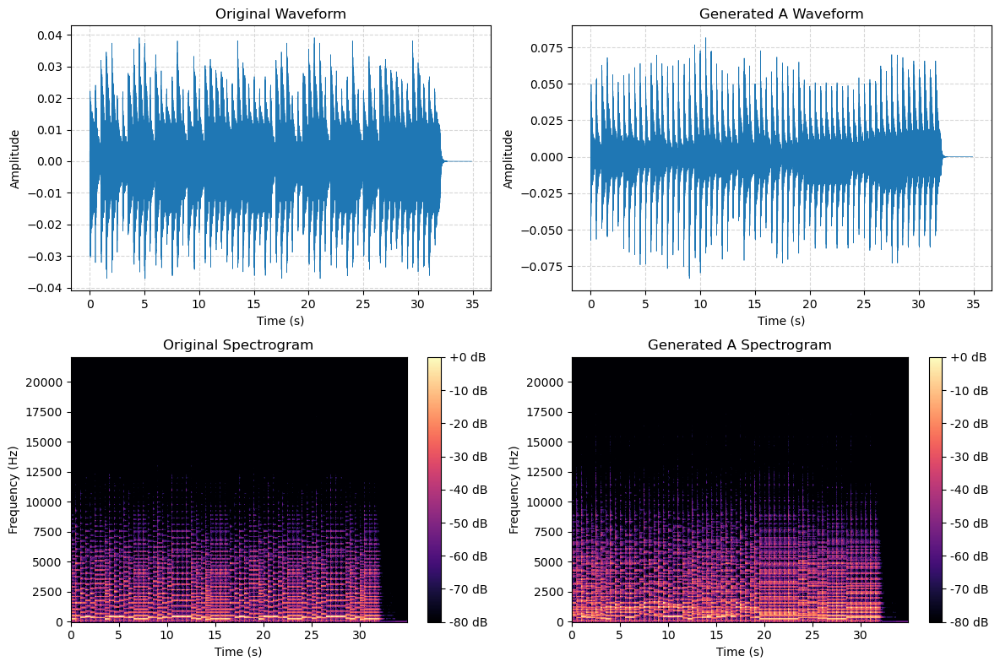

In [ ]:
fig, axes = plt.subplots(2, 2, figsize=(12, 8), sharex=False)

# Original waveform (top-left)
plot_waveform("original.wav",     axes[0, 0], title="Original Waveform")
# Generated A waveform (top-right)
plot_waveform("generated_A.wav",   axes[0, 1], title="Generated A Waveform")

# Original spectrogram (bottom-left)
plot_spectrogram("original.wav",   axes[1, 0], title="Original Spectrogram")
# Generated A spectrogram (bottom-right)
plot_spectrogram("generated_A.wav", axes[1, 1], title="Generated A Spectrogram")

plt.tight_layout()
plt.show()

### Compare Original vs Generated B (single‐note): Waveform & Spectrogram

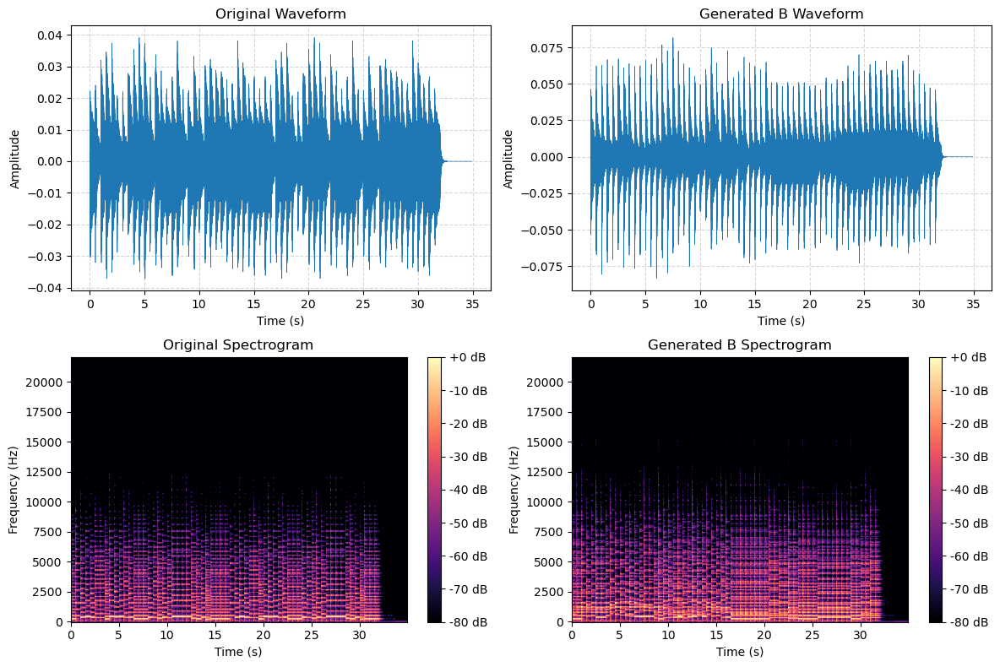

In [ ]:
fig, axes = plt.subplots(2, 2, figsize=(12, 8), sharex=False)

# Original waveform (top-left)
plot_waveform("original.wav",      axes[0, 0], title="Original Waveform")
# Generated B waveform (top-right)
plot_waveform("generated_B.wav",    axes[0, 1], title="Generated B Waveform")

# Original spectrogram (bottom-left)
plot_spectrogram("original.wav",    axes[1, 0], title="Original Spectrogram")
# Generated B spectrogram (bottom-right)
plot_spectrogram("generated_B.wav",  axes[1, 1], title="Generated B Spectrogram")

plt.tight_layout()
plt.show()

### Compare Original vs Generated C (fixed4‐prefix): Waveform & Spectrogram

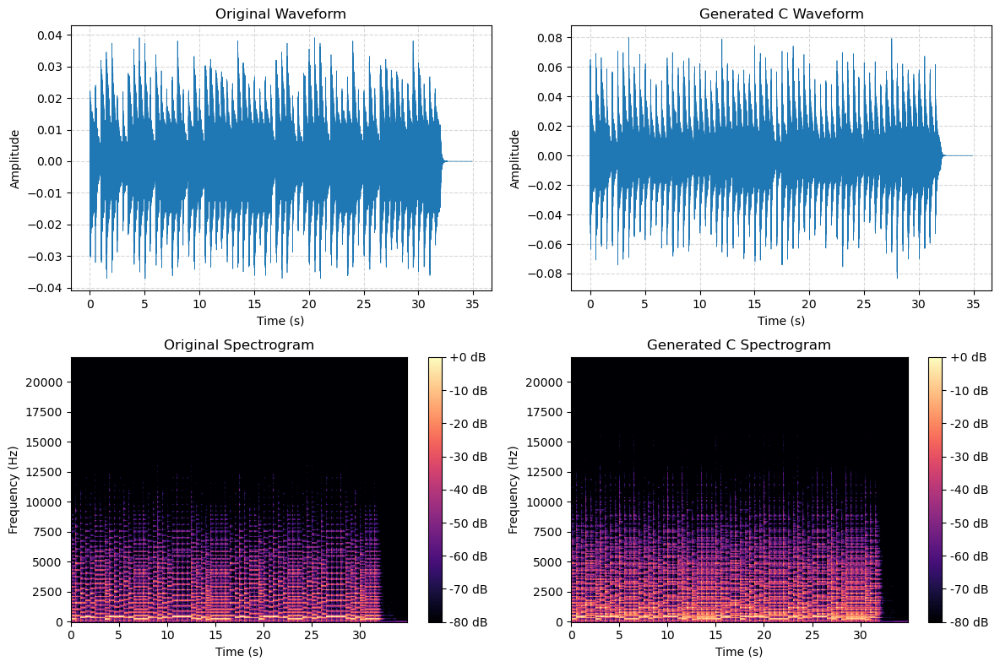

In [ ]:
fig, axes = plt.subplots(2, 2, figsize=(12, 8), sharex=False)

# Original waveform (top-left)
plot_waveform("original.wav",      axes[0, 0], title="Original Waveform")
# Generated C waveform (top-right)
plot_waveform("generated_C.wav",    axes[0, 1], title="Generated C Waveform")

# Original spectrogram (bottom-left)
plot_spectrogram("original.wav",    axes[1, 0], title="Original Spectrogram")
# Generated C spectrogram (bottom-right)
plot_spectrogram("generated_C.wav",  axes[1, 1], title="Generated C Spectrogram")

plt.tight_layout()
plt.show()

## Evaluation (Four‐Voice Chord Model)

### 1. Chord‐Level Cross‐Entropy Loss and Perplexity

We evaluate the four‐voice model on held‐out splits:

1. Preprocess **validation** and **test** chorales into chord‐tuples.
2. Tokenize each chord tuple with `chord_to_idx`.
3. Build `ChordSequenceDataset` / `DataLoader` for each split.
4. Use our `evaluate()` helper to compute chord‐level average cross‐entropy loss and perplexity.
5. Print validation & test metrics.

In [ ]:
# 1. Preprocess valid & test splits into four‐voice chord sequences
def extract_chord_seqs(chorales, min_len=10):
    seqs = []
    for chorale in chorales:
        chord_list = []
        for chord in chorale:
            # Chord is a 4‐tuple or -1; keep only valid 4‐tuples
            if isinstance(chord, (list, tuple)) and len(chord) == 4:
                chord_tuple = (int(chord[0]), int(chord[1]), int(chord[2]), int(chord[3]))
                if chord_tuple != (-1, -1, -1, -1):
                    chord_list.append(chord_tuple)
        if len(chord_list) > min_len:
            seqs.append(chord_list)
    return seqs

valid_chord_seqs = extract_chord_seqs(data["valid"])
test_chord_seqs  = extract_chord_seqs(data["test"])

In [41]:
# 2. Tokenize using chord_to_idx (drops unseen chords)
valid_chord_tokens = [
    [chord_to_idx[ch] for ch in seq if ch in chord_to_idx]
    for seq in valid_chord_seqs
]
test_chord_tokens = [
    [chord_to_idx[ch] for ch in seq if ch in chord_to_idx]
    for seq in test_chord_seqs
]

# Build chord‐level datasets & dataloaders
val_dataset_ch  = ChordSequenceDataset(valid_chord_tokens, seq_len=seq_len)
test_dataset_ch = ChordSequenceDataset(test_chord_tokens,  seq_len=seq_len)
val_loader_ch   = DataLoader(val_dataset_ch,  batch_size=batch_size)
test_loader_ch  = DataLoader(test_dataset_ch, batch_size=batch_size)

print(f"Validation chord samples: {len(val_dataset_ch)},  Test chord samples: {len(test_dataset_ch)}")

Validation chord samples: 1258,  Test chord samples: 1396


In [ ]:
# 3. Evaluation helper
def evaluate(model, loader, vocab_size, device="cuda" if torch.cuda.is_available() else "cpu"):
    model.eval()
    loss_fn = nn.CrossEntropyLoss(reduction="sum")
    total_loss = 0.0
    total_tokens = 0
    
    with torch.no_grad():
        for xb, yb in loader:
            xb, yb = xb.to(device), yb.to(device)
            logits = model(xb)  # (batch, seq_len, vocab_size)
            
            loss = loss_fn(
                logits.view(-1, vocab_size),
                yb.view(-1)
            )
            total_loss += loss.item()
            total_tokens += yb.numel()
    
    avg_loss = total_loss / total_tokens
    ppl = np.exp(avg_loss)
    return avg_loss, ppl

# 4. Run chord‐level evaluation
val_loss_ch, val_ppl_ch   = evaluate(model, val_loader_ch,  vocab_size)
test_loss_ch, test_ppl_ch = evaluate(model, test_loader_ch, vocab_size)

print(f"Validation (chords)  —  Loss: {val_loss_ch:.4f},  Perplexity: {val_ppl_ch:.2f}")
print(f"Test (chords)        —  Loss: {test_loss_ch:.4f},  Perplexity: {test_ppl_ch:.2f}")

Validation (chords)  —  Loss: 7.3067,  Perplexity: 1490.21
Test (chords)        —  Loss: 7.2839,  Perplexity: 1456.60


#### Interpretation (Chord Level)

- **Validation loss = 7.3067** (perplexity ≈ 1490.21)  
- **Test loss = 7.2839** (perplexity ≈ 1456.60)  

A chord‐level perplexity of ~1457–1490 indicates the model is effectively choosing among ~1,450 equally likely four‐voice chord tokens at each step. The small gap between validation and test perplexities suggests the model generalizes reasonably well at the chord level, though absolute perplexity remains high (likely because the chord vocabulary is large).

### 2. Voice‐Specific Pitch Statistics
Next, we inspect each individual voice (soprano, alto, tenor, bass) to see whether the model captures their marginal pitch distributions. For each voice:

1. Flatten all pitches of that voice in the test set.
2. Flatten all pitches of that voice in one generated sample (we’ll use “Generated A (random4)”).
3. Compute mean & standard deviation for both.
4. Plot histograms side by side (test vs generated).

In [ ]:
# Flatten test set pitches for each of the 4 voices
# test_chord_tokens is a list of chord‐index sequences; convert back to chord_tuples
test_voice_pitches = {i: [] for i in range(4)}  # 0=soprano, 1=alto, 2=tenor, 3=bass

for seq in test_chord_tokens:
    for chord_idx in seq:
        chord_tuple = idx_to_chord[chord_idx]  # (soprano, alto, tenor, bass)
        for voice_idx in range(4):
            test_voice_pitches[voice_idx].append(chord_tuple[voice_idx])

# Flatten generated sample A (“random4”) pitches for each voice
gen_chord_ids_A = gens["A_random4"]  # list of chord‐indices
gen_voice_pitches_A = {i: [] for i in range(4)}

for chord_idx in gen_chord_ids_A:
    chord_tuple = idx_to_chord[chord_idx]
    for voice_idx in range(4):
        gen_voice_pitches_A[voice_idx].append(chord_tuple[voice_idx])

# Compute mean & std for each voice (test vs generated A)
for v in range(4):
    mean_test = np.mean(test_voice_pitches[v])
    std_test  = np.std(test_voice_pitches[v])
    mean_gen  = np.mean(gen_voice_pitches_A[v])
    std_gen   = np.std(gen_voice_pitches_A[v])
    voice_name = ["Soprano","Alto","Tenor","Bass"][v]
    print(f"{voice_name}:")
    print(f"  Test   mean = {mean_test:.2f}, std = {std_test:.2f}")
    print(f"  Gen A  mean = {mean_gen:.2f}, std = {std_gen:.2f}\n")

Soprano:
  Test   mean = 63.11, std = 5.36
  Gen A  mean = 66.30, std = 4.60

Alto:
  Test   mean = 71.99, std = 4.58
  Gen A  mean = 75.64, std = 3.62

Tenor:
  Test   mean = 77.66, std = 4.59
  Gen A  mean = 81.00, std = 3.28

Bass:
  Test   mean = 83.13, std = 4.99
  Gen A  mean = 85.67, std = 2.97



#### Interpretation (Voice Marginals)

- **Soprano**: Test (63.11 ± 5.36), Gen A (66.30 ± 4.60). The generated soprano is shifted ~3 semitones higher on average and slightly less variable.  
- **Alto**: Test (71.99 ± 4.58), Gen A (75.64 ± 3.62). The generated alto is ~3.65 semitones higher.  
- **Tenor**: Test (77.66 ± 4.59), Gen A (81.00 ± 3.28). The generated tenor is ~3.34 semitones higher.  
- **Bass**: Test (83.13 ± 4.99), Gen A (85.67 ± 2.97). The generated bass is ~2.54 semitones higher.  

All four voices in the generated sample are biased toward higher pitches compared to the test set, and their variances are slightly reduced. This indicates the model has learned pitch ranges but drifts upward in all voices.

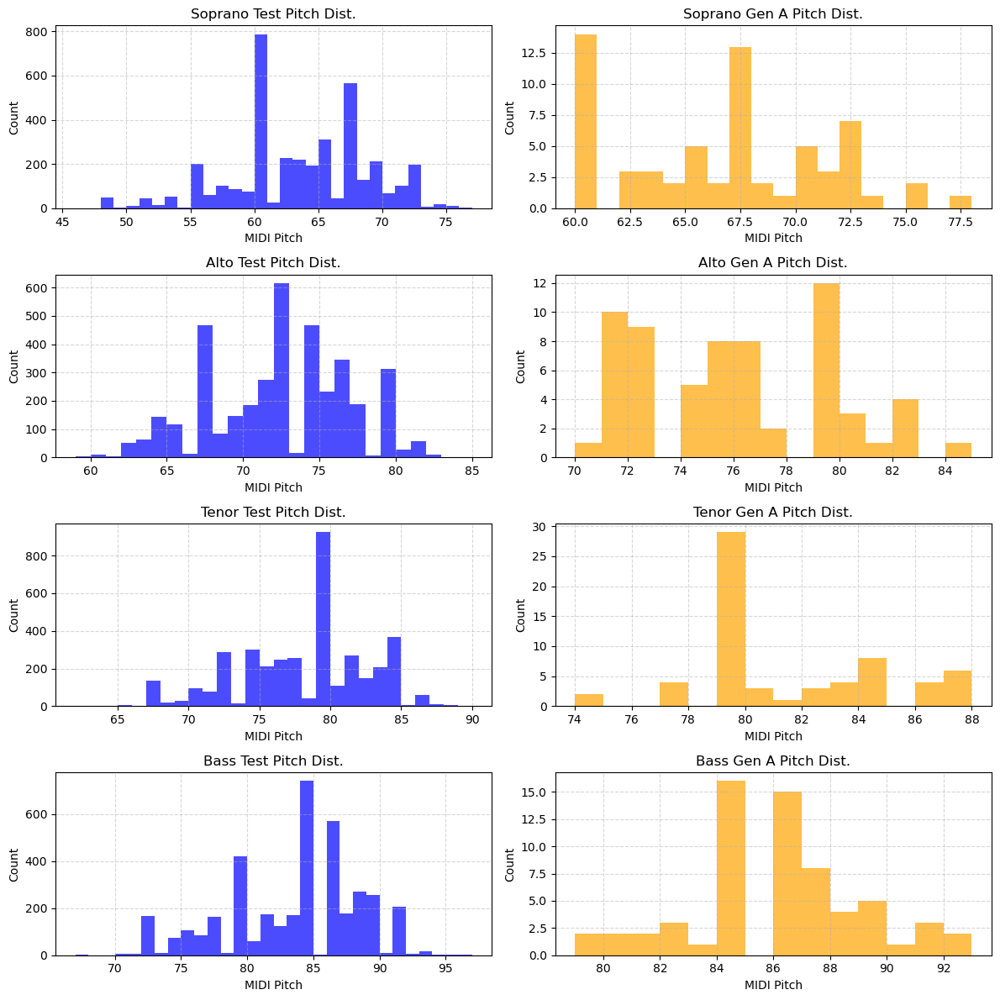

In [ ]:
# Plot histograms (Test vs Generated A) for each voice
voice_labels = ["Soprano", "Alto", "Tenor", "Bass"]
fig, axes = plt.subplots(4, 2, figsize=(12, 12), sharey=False)

for v in range(4):
    # Test histogram (left column)
    axes[v, 0].hist(
        test_voice_pitches[v],
        bins=range(min(test_voice_pitches[v]), max(test_voice_pitches[v]) + 2),
        color='blue',
        alpha=0.7
    )
    axes[v, 0].set_title(f"{voice_labels[v]} Test Pitch Dist.")
    axes[v, 0].set_xlabel("MIDI Pitch")
    axes[v, 0].set_ylabel("Count")
    axes[v, 0].grid(True, linestyle='--', alpha=0.5)

    # Generated A histogram (right column)
    axes[v, 1].hist(
        gen_voice_pitches_A[v],
        bins=range(min(gen_voice_pitches_A[v]), max(gen_voice_pitches_A[v]) + 2),
        color='orange',
        alpha=0.7
    )
    axes[v, 1].set_title(f"{voice_labels[v]} Gen A Pitch Dist.")
    axes[v, 1].set_xlabel("MIDI Pitch")
    axes[v, 1].set_ylabel("Count")
    axes[v, 1].grid(True, linestyle='--', alpha=0.5)

plt.tight_layout()
plt.show()

### 3. Voice‐Transition (Bigram) Analysis
To see if the model learns realistic voice‐step transitions, we compare bigram frequencies (consecutive‐note pairs) in the test set vs. the generated sample for each voice. We will:

1. Build bigram counts for each voice in test set: count all pairs (pitch_t, pitch_{t+1}).
2. Build bigram counts for each voice in one generated sample (A).
3. Convert these counts to conditional distributions P(next_pitch | current_pitch) and measure KL divergence from test to generated, per voice.

In [ ]:
def compute_bigram_probs(pitch_sequence):
    """Given a list of pitches, returns dict: { current_pitch: { next_pitch: prob } }."""
    counts = {}
    for (p1, p2) in zip(pitch_sequence[:-1], pitch_sequence[1:]):
        counts.setdefault(p1, collections.Counter())
        counts[p1][p2] += 1
    # Normalize to probabilities
    bigram_probs = {}
    for p1, counter in counts.items():
        total = sum(counter.values())
        bigram_probs[p1] = {p2: count / total for p2, count in counter.items()}
    return bigram_probs

def kl_divergence(p_dist, q_dist):
    """
    Compute KL(P || Q) where P and Q are dicts of { symbol: prob }.
    Missing symbols in Q receive a small epsilon probability.
    """
    epsilon = 1e-8
    kl = 0.0
    for symbol, p_val in p_dist.items():
        q_val = q_dist.get(symbol, epsilon)
        kl += p_val * math.log(p_val / q_val)
    return kl

# Build bigram distributions for each voice in test set
test_bigram = {}
for v in range(4):
    test_bigram[v] = compute_bigram_probs(test_voice_pitches[v])

# Build bigram distributions for each voice in generated A
gen_bigram_A = {}
for v in range(4):
    gen_bigram_A[v] = compute_bigram_probs(gen_voice_pitches_A[v])

# Compute average KL divergence across all current_pitch contexts, per voice
kl_results = {}
for v in range(4):
    kl_sum, count = 0.0, 0
    for p1, p_dist in test_bigram[v].items():
        q_dist = gen_bigram_A[v].get(p1, {})
        kl_sum += kl_divergence(p_dist, q_dist)
        count += 1
    kl_results[v] = kl_sum / count if count > 0 else float('nan')

# Print KL divergence for each voice
for v in range(4):
    print(f"{voice_labels[v]} KL divergence (Test || Gen A) = {kl_results[v]:.4f}")

Soprano KL divergence (Test || Gen A) = 13.9683
Alto KL divergence (Test || Gen A) = 12.3597
Tenor KL divergence (Test || Gen A) = 13.4401
Bass KL divergence (Test || Gen A) = 13.4021


#### Interpretation (Voice Bigram KL)

- Each voice’s KL divergence is around 12–14. This large value means the generated voice‐leading transitions differ substantially from the test distribution. In other words, the model’s step‐to‐step pitch choices for each voice don’t closely match the test chorales.

### 4. Chord‐Transition (Bigram) Analysis
Finally, we check whether the model’s predicted chord transitions (4‐voice bigrams) match those in the test set:

1. Build test‐set bigram counts on chord‐indices.
2. Build generated sample A bigram counts on chord‐indices.
3. Compute KL divergence of chord‐transition distributions.

In [ ]:
# Build bigram distributions on chord‐indices (test set)
test_chords_flat = [idx for seq in test_chord_tokens for idx in seq]
test_chord_bigram = compute_bigram_probs(test_chords_flat)

# Build bigram distributions on chord‐indices (generated A)
gen_chord_bigram_A = compute_bigram_probs(gen_chord_ids_A)

# Compute KL divergence for each chord context
kl_sum, count = 0.0, 0
for c1, p_dist in test_chord_bigram.items():
    q_dist = gen_chord_bigram_A.get(c1, {})
    kl_sum += kl_divergence(p_dist, q_dist)
    count += 1
kl_chord = kl_sum / count if count > 0 else float('nan')

print(f"Chord‐level KL divergence (Test || Gen A) = {kl_chord:.4f}")

Chord‐level KL divergence (Test || Gen A) = 17.6501


#### Interpretation (Chord Bigram KL Divergence)

- A chord‐level KL of ~17.65 is very large, indicating the generated chord‐to‐chord transitions deviate greatly from the test distribution. The model is not capturing four‐voice harmonic progressions as faithfully as expected.

## Overall Evaluation Summary

1. **Chord‐Level Perplexity**:  
   - Validation ≈ 1490.21, Test ≈ 1456.60  
   This high perplexity reflects the large chord vocabulary (~1,500 distinct chords) and shows the model still struggles to narrow down its predictions reliably.

2. **Voice Marginals**:  
   - Generated voices (Gen A) skew higher in pitch (≈ +2–4 semitones) relative to the test distributions, with slightly lower variance.

3. **Voice Bigram KL Divergences** (Test‖Gen A):  
   - Soprano ≈ 13.97  
   - Alto    ≈ 12.36  
   - Tenor   ≈ 13.44  
   - Bass    ≈ 13.40  
   These large KL values indicate the model’s stepwise pitch transitions do not match the test set well for any voice.

4. **Chord Bigram KL Divergence**:  
   - ≈ 17.65  
   The four‐voice harmonic transitions in generated chords differ significantly from those in the held‐out chorales.

Taken together, the evaluation shows that, although the model has learned to generate plausible chord shapes (it still produces four‐voice chords), its distributions—both marginal and sequential—drift noticeably from the test data. There is ample room for improvement (e.g., more training data, larger/deeper architectures, attention to balancing pitch ranges).

## Task 2 (NEW)

## Overview

We extended the functionality of the Piano Genie project by Google to generate music based on words typed with the full QWERTY keyboard. This allows us to also feed in and output velocity into the model, where the project did not do so before.

The original Github for the project can be found here: https://github.com/chrisdonahue/piano-genie

### Inspiration

Monkeytype is a popular typing speed website that some of our members frequent. We were curious to see if we could generate music dynamically based on what the user was typing
https://monkeytype.com/

We saw the Piano Genie demo in class, and saw an opportunity to extend it to explore this idea. The original demo can be found here:
https://www.i-am.ai/piano-genie.html


## Usage

Use our utility HTML script to open a window where you can type out a paragraph. The HTML script will encode your typing as a combination of keys clicked, timestamp, and your word per minute.


The utility script will output these stats to a `.csv` file that can be passed into the model to generate new music.

## QWERTY Input

We experimented with a few different ideas for how the QWERTY keyboard could augment what music is played.

### Velocity per row

We tested assigning each row of a keyboard to different velocities to be encoded during typing. For instance, the row with the keys "QWERTYUIOP" would be assigned a higher velocity value than the row with the keys "ZXCVBNM".

We kept 8 note bins (forcing keys past the 8th in the row counting left to right to represent the 8th bin) during our initial experiments.


## Notes

We left some of the original documentation in to assist with setting context and if the project reviewers are interested in what work was done before. All original documentation in pure markdown blocks have been surrounded by codeblocks, which can be removed for your viewing convenience. Additionally, inline markdown is most likely partially or fully from the original repository. We mark documentation written fully by us with the tag (NEW). Also credit to copilot for assistance with the project.

## Performance Encoding (NEW)

We created a new system in order to encode our user's musical performance on a QWERTY keyboard into a format interpretable by a machine learning model.

### User UI

<center><img src="https://raw.githubusercontent.com/AnniePhan02/CSE253-Assignment2/main/task2/images/NewInputSystem.png" width=600px/></center>

The new UI for adding text is a simple text input box, with the ability to click in and type text. The user can then download their performance as a CSV file using the `Download CSV` button.

### CSV File Format

The first row of the CSV file is a header, containing the following column names:
* Key: This column stores the key pressed by the user on the QWERTY keyboard.
* Seconds: This column stores the time elapsed in seconds since the very first key press. The time is recorded with three decimal places.
* WPM: This column stores the words per minute calculated at the moment the key was pressed. The WPM is recorded with one decimal place.

Each subsequent row after the first in the CSV file represents a single key press event. The values in these rows correspond to the columns defined in the header: the specific key pressed, the time of the key press, and the calculated words per minute at that moment.

For example, the row `I,3.496,10.3` indicates that the key "I" was pressed at 3.496 seconds after the initial key press, and at that time, the user's typing speed was 10.3 words per minute.

### Example CSV of Short Performance

In the below performance, the phrase `I am going to pass` was typed into the terminal.

```
Key,Seconds,WPM
Shift,0.000,Infinity
Shift,3.373,7.1
I,3.496,10.3
 ,3.622,13.3
w,3.697,16.2
Backspace,3.957,18.2
a,4.023,20.9
m,4.121,23.3
 ,4.229,25.5
g,4.298,27.9
o,4.399,30.0
i,4.538,31.7
n,4.591,34.0
g,4.665,36.0
 ,4.731,38.0
t,4.798,40.0
o,4.837,42.2
 ,4.923,43.9
p,5.040,45.2
a,5.102,47.0
s,5.246,48.0
s,5.367,49.2

```


### Full Script For User Input

```HTML
<!DOCTYPE html>
<html>
  <body>
    <textarea id="t" rows="10" cols="60" placeholder="Start typing…"></textarea>
    <br />
    <button id="download">Download CSV</button>

    <script>
      let startTime = null;
      let charCount = 0;
      // Header: Key, Seconds since first press, WPM at that moment
      const rows = [["Key", "Seconds", "WPM"]];

      const log = (key, secs, wpm) => {
        rows.push([key, secs.toFixed(3), wpm.toFixed(1)]);
      };

      document.getElementById("t").addEventListener("keydown", (e) => {
        if (startTime === null) {
          startTime = performance.now();
        }
        charCount++;
        const now = performance.now();
        const elapsedMs = now - startTime;
        const elapsedSecs = elapsedMs / 1000;
        const elapsedMins = elapsedMs / 60000;
        // WPM = (chars ÷ 5) ÷ elapsedMinutes
        const wpm = charCount / 5 / elapsedMins;
        log(e.key, elapsedSecs, wpm);
      });

      document.getElementById("download").addEventListener("click", () => {
        const csvContent = rows.map((r) => r.join(",")).join("\n");
        const blob = new Blob([csvContent], { type: "text/csv" });
        const url = URL.createObjectURL(blob);
        const a = document.createElement("a");
        a.href = url;
        a.download = "typing_wpm_timestamps.csv";
        document.body.appendChild(a);
        a.click();
        document.body.removeChild(a);
        URL.revokeObjectURL(url);
      });
    </script>
  </body>
</html>
```

## Initial tests:

During our initial tests on whether or not we could get the pipeline to run, we converted our performance into 8 bins using the following script:

In [ ]:
# version 1
def letter_to_button_keyboard(letter):
    # Map letters on the keyboard to button indices, top row, middle row, bottom row
    top = "qwertyuiop"
    middle = "asdfghjkl"
    bottom = "zxcvbnm"
    if letter in top:
        return min(top.index(letter), 8), 40
    elif letter in middle:
        return min(middle.index(letter), 8), 80
    elif letter in bottom:
        return min(bottom.index(letter), 8), 120
    else:
        return 0, 0

After working through the missing dependencies and various setup quirks, we were able to generate this with our input script and new music:

In [ ]:
# Convert chord-indices → write a four-voice MIDI


# Convert original 4-voice (first 64 chords) and each generated version to WAV
fs = FluidSynth("FluidR3_GM.sf2")
fs.midi_to_audio("output_1748243578.2774305.mid", "output_1748243578.2774305.wav")
fs.midi_to_audio("output_1748243604.4184122.mid",   "output_1748243604.4184122.wav")
fs.midi_to_audio("output_1748243854.1907494.mid",   "output_1748243854.1907494.wav")
fs.midi_to_audio("output_1748243963.1448758.mid",   "output_1748243963.1448758.wav")

# Play back and display audio in notebook
# print("🎹 Attempt 1:")
# display(Audio("output_1748243578.wav"))

# print("🎹 Attempt 2:")
# display(Audio("output_1748243604.wav"))

# print("🎹 Attempt 3:")
# display(Audio("output_1748243854.wav"))

# print("🎹 Attempt 4:")
# display(Audio("output_1748243963.wav"))

## Pipeline (NEW):

Below are our modifications to the original pipeline. The pipeline has been modified in order to use the following inputs and outputs:

*   Input: our new CSV file format representing what keys users have clicked while typing
*   Output: A MIDI file that converts general music "bins" (where the bins are the keys the users clicked) to proper notes. In other words, converts our user's keyboard input into a musical piece.

We have modified the pipeline to accept **26 bins**, and also output **velocity**.



<!-- # Music Co-creation Tutorial Part 1: Training a generative model of music
### [Chris Donahue](https://chrisdonahue.com), [Anna Huang](https://research.google/people/105787/), [Jon Gillick](https://www.jongillick.com/)

This is the first part of a two-part tutorial entitled [*Interactive music co-creation with PyTorch and TensorFlow.js*](https://github.com/chrisdonahue/music-cocreation-tutorial/), prepared as part of the ISMIR 2021 tutorial *Designing generative models for interactive co-creation*. This part of the tutorial will demonstrate how to **train a generative model of music in PyTorch**, and **port its weights to TensorFlow.js** format for interaction. The [final result is here](https://chrisdonahue.com/music-cocreation-tutorial)—see our [GitHub repo](https://github.com/chrisdonahue/music-cocreation-tutorial/) for part 2. -->


```
## Primer on Piano Genie

The generative model we will train is called [Piano Genie](https://magenta.tensorflow.org/pianogenie) (Donahue et al. 2019). Piano Genie is a system which maps amateur improvisations on a miniature 8-button keyboard ([video](https://www.youtube.com/watch?v=YRb0XAnUpIk), [demo](https://piano-genie.glitch.me)) into realistic performances on a full 88-key piano.

To achieve this, Piano Genie adopts an _autoencoder_ approach. First, an _encoder_ maps professional piano performances into this 8-button space. Then, a _decoder_ attempts to reconstruct the original piano performance from the 8-button version. The entire system is trained end-to-end to minimize the decoder's reconstruction error. At performance time, we replace the encoder with a user improvising on an 8-button controller, and use the pre-trained decoder to generate a corresponding piano performance.

<center><img src="https://raw.githubusercontent.com/chrisdonahue/music-cocreation-tutorial/main/part-1-py-training/figures/overview.png" width=600px/></center>

At a low-level, both the encoder and the decoder for Piano Genie are lightweight recurrent neural networks, which are suitable for real-time performance even on mobile CPUs. The discrete bottleneck is achieved using a technique called _integer-quantized autoencoding_ (IQAE), which was also proposed in the Piano Genie paper.
```

In [16]:
#@title **(Step 1)** Parse MIDI piano performances into simple lists of notes

# @markdown *Note*: Check this box to rebuild the dataset from scratch.
REBUILD_DATASET = False  # @param{type:"boolean"}

# @markdown To train Piano Genie, we will use a dataset of professional piano performances called [MAESTRO](https://magenta.tensorflow.org/datasets/maestro) (Hawthorne et al. 2019).
# @markdown Each performance in this dataset was captured by a Disklavier, a computerized piano which can record human performances in MIDI format, i.e., as timestamped sequences of notes.

PIANO_LOWEST_KEY_MIDI_PITCH = 21
PIANO_NUM_KEYS = 88

import gzip
import json
from collections import defaultdict

from tqdm.notebook import tqdm


def download_and_parse_maestro():
    # Install pretty_midi
    !pip install pretty_midi
    import pretty_midi

    # Download MAESTRO dataset (Hawthorne+ 2018)
    # !wget -nc https://storage.googleapis.com/magentadata/datasets/maestro/v2.0.0/maestro-v2.0.0-midi.zip
    !unzip maestro-v2.0.0-midi.zip

    # Parse MAESTRO dataset
    dataset = defaultdict(list)
    with open("maestro-v2.0.0/maestro-v2.0.0.json", "r") as f:
        for attrs in tqdm(json.load(f)):
            split = attrs["split"]
            midi = pretty_midi.PrettyMIDI("maestro-v2.0.0/" + attrs["midi_filename"])
            assert len(midi.instruments) == 1
            # @markdown Formally, a piano performance is a sequence of notes: $\mathbf{x} = (x_1, \ldots, x_N)$, where each $x_i = (t_i, d_i, k_i, v_i)$, signifying:
            notes = [
                (
                    # @markdown 1. (When the key was pressed) An _onset_ time $t_i \in \mathbb{T}$, where $\mathbb{T} = \{ t \in \mathbb{R} \mid 0 \leq t \leq T \}$
                    float(n.start),
                    # @markdown 2. (How long the key was held) A _duration_ $d_i \in \mathbb{R}_{>0}$
                    float(n.end) - float(n.start),
                    # @markdown 3. (Which key was pressed) A _key_ index $k_i \in \mathbb{K}$, where $\mathbb{K} = \{\text{A0}, \ldots, \text{C8}\}$ and $|\mathbb{K}| = 88$
                    int(n.pitch - PIANO_LOWEST_KEY_MIDI_PITCH),
                    # @markdown 4. (How hard the key was pressed) A _velocity_ $v_i \in \mathbb{V}$, where $\mathbb{V} = \{1, \ldots, 127\}$
                    int(n.velocity),
                )
                for n in midi.instruments[0].notes
            ]

            # This list is in sorted order of onset time, i.e., $t_{i-1} \leq t_i ~\forall~i \in \{2, \ldots, N\}$.
            notes = sorted(notes, key=lambda n: (n[0], n[2]))
            assert all(
                [
                    all(
                        [
                            # Start times should be non-negative
                            n[0] >= 0,
                            # Note durations should be strictly positive, i.e., $d_i > 0$
                            n[1] > 0,
                            # Key index should be in range of the piano
                            0 <= n[2] and n[2] < PIANO_NUM_KEYS,
                            # Velocity should be valid
                            1 <= n[3] and n[3] < 128,
                        ]
                    )
                    for n in notes
                ]
            )
            dataset[split].append(notes)

        return dataset


if REBUILD_DATASET:
    DATASET = download_and_parse_maestro()
    with gzip.open("maestro-v2.0.0-simple.json.gz", "w") as f:
        f.write(json.dumps(DATASET).encode("utf-8"))
else:
    # !wget -nc https://github.com/chrisdonahue/music-cocreation-tutorial/raw/main/part-1-py-training/data/maestro-v2.0.0-simple.json.gz
    with gzip.open("maestro-v2.0.0-simple.json.gz", "rb") as f:
        DATASET = json.load(f)

print([(s, len(DATASET[s])) for s in ["train", "validation", "test"]])

[('train', 967), ('validation', 137), ('test', 178)]


In [17]:
# Step 1: Inspect the data structure and content
print("Dataset splits and number of performances:")
for split, performances in DATASET.items():
    print(f"- {split}: {len(performances)} performances")

# Inspect the first performance in the training set
if DATASET['train']:
    first_performance = DATASET['train'][0]
    print("\nStructure of the first performance (first 5 notes):")
    print(first_performance[:5])
    print("\nData types of the first note:")
    if first_performance:
        first_note = first_performance[0]
        for i, value in enumerate(first_note):
            print(f"- Element {i}: {type(value)}")

Dataset splits and number of performances:
- train: 967 performances
- validation: 137 performances
- test: 178 performances

Structure of the first performance (first 5 notes):
[[0.9830729166666666, 0.8268229166666666, 46, 52], [1.7838541666666665, 0.12239583333333348, 51, 67], [2.1471354166666665, 1.453125, 57, 65], [2.153645833333333, 2.170572916666667, 50, 45], [2.1783854166666665, 1.0651041666666665, 40, 39]]

Data types of the first note:
- Element 0: <class 'float'>
- Element 1: <class 'float'>
- Element 2: <class 'int'>
- Element 3: <class 'int'>


In [18]:
# Install necessary libraries
%pip install pandas matplotlib seaborn numpy

  Using cached seaborn-0.13.2-py3-none-any.whl.metadata (5.4 kB)
  Using cached pytz-2025.2-py2.py3-none-any.whl.metadata (22 kB)
  Using cached tzdata-2025.2-py2.py3-none-any.whl.metadata (1.4 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.3/11.3 MB 15.2 MB/s eta 0:00:00 0:00:01
Using cached seaborn-0.13.2-py3-none-any.whl (294 kB)
Using cached pytz-2025.2-py2.py3-none-any.whl (509 kB)
Using cached tzdata-2025.2-py2.py3-none-any.whl (347 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4/4 [seaborn]m3/4 [seaborn]
Note: you may need to restart the kernel to use updated packages.


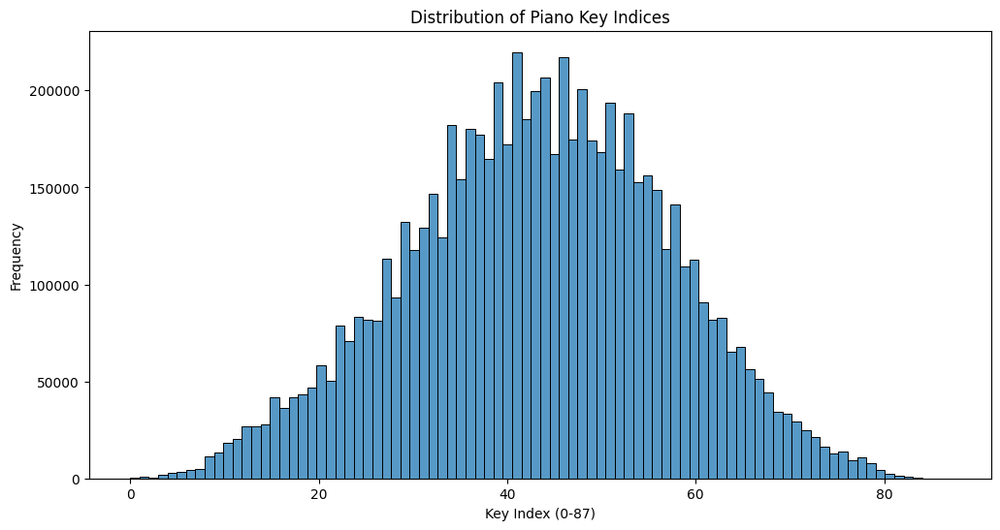

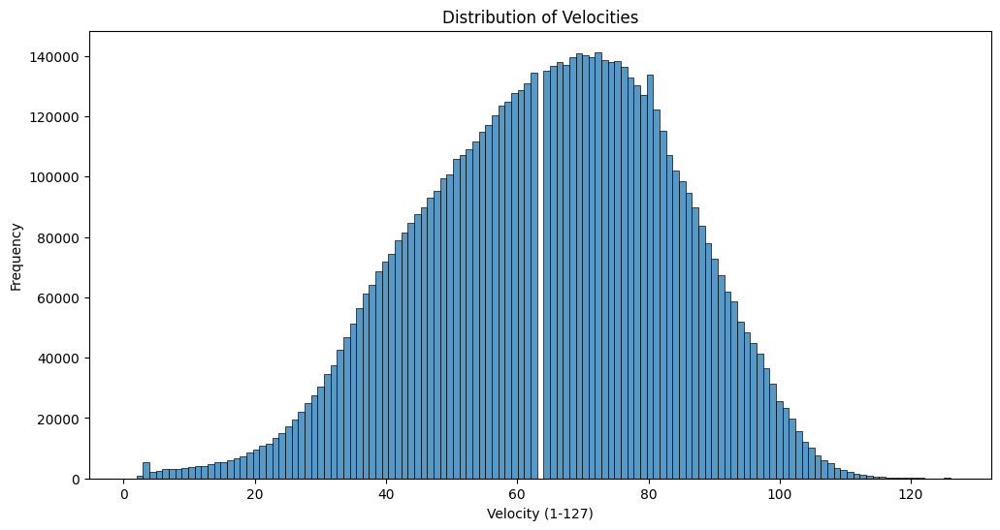

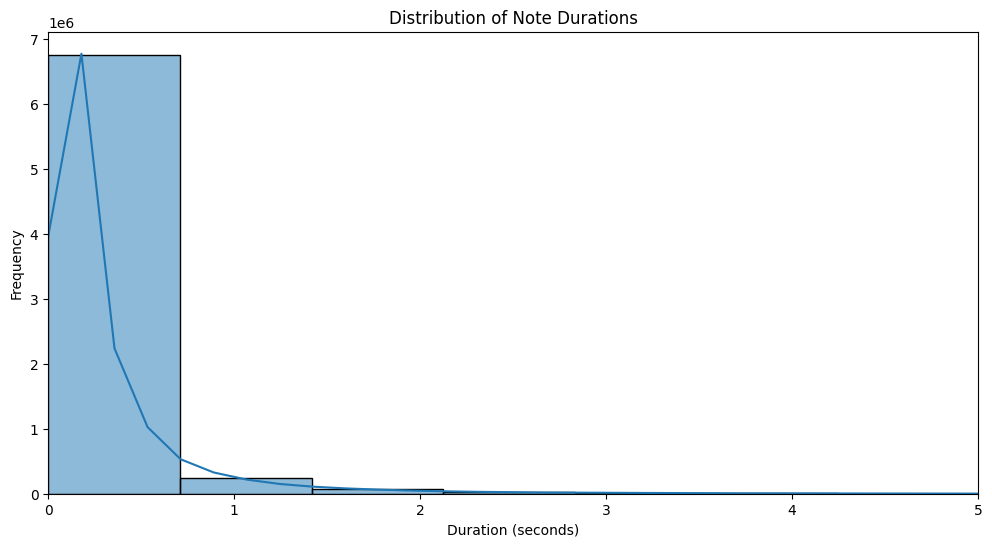

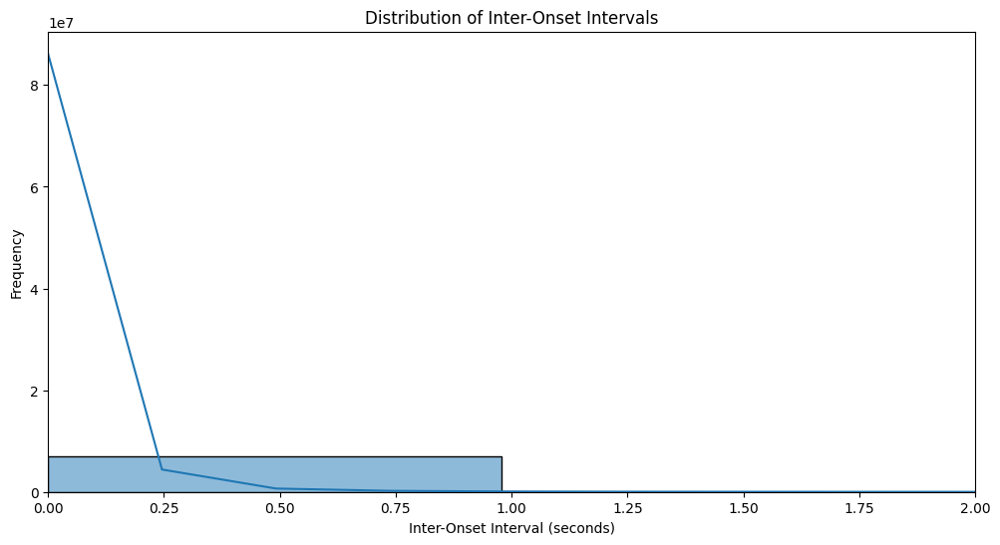

In [19]:


import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Step 2: Analyze note properties

# Combine all notes from all splits into a single list for analysis
all_notes = []
for split, performances in DATASET.items():
    for performance in performances:
        all_notes.extend(performance)

# Create a pandas DataFrame for easier analysis
notes_df = pd.DataFrame(all_notes, columns=['onset_time', 'duration', 'key_index', 'velocity'])

# Distribution of key indices
plt.figure(figsize=(12, 6))
sns.histplot(notes_df['key_index'], bins=PIANO_NUM_KEYS, kde=False)
plt.title('Distribution of Piano Key Indices')
plt.xlabel('Key Index (0-87)')
plt.ylabel('Frequency')
plt.show()

# Distribution of velocities
plt.figure(figsize=(12, 6))
sns.histplot(notes_df['velocity'], bins=127, kde=False)
plt.title('Distribution of Velocities')
plt.xlabel('Velocity (1-127)')
plt.ylabel('Frequency')
plt.show()

# Distribution of durations
plt.figure(figsize=(12, 6))
sns.histplot(notes_df['duration'], bins=50, kde=True)
plt.title('Distribution of Note Durations')
plt.xlabel('Duration (seconds)')
plt.ylabel('Frequency')
plt.xlim(0, 5) # Limit x-axis for better visualization of common durations
plt.show()

# Distribution of inter-onset intervals
# Calculate inter-onset intervals for each performance
all_iois = []
for split, performances in DATASET.items():
    for performance in performances:
        onsets = [n[0] for n in performance]
        iois = np.diff(onsets)
        all_iois.extend(iois)

plt.figure(figsize=(12, 6))
sns.histplot(all_iois, bins=50, kde=True)
plt.title('Distribution of Inter-Onset Intervals')
plt.xlabel('Inter-Onset Interval (seconds)')
plt.ylabel('Frequency')
plt.xlim(0, 2) # Limit x-axis for better visualization of common intervals
plt.show()

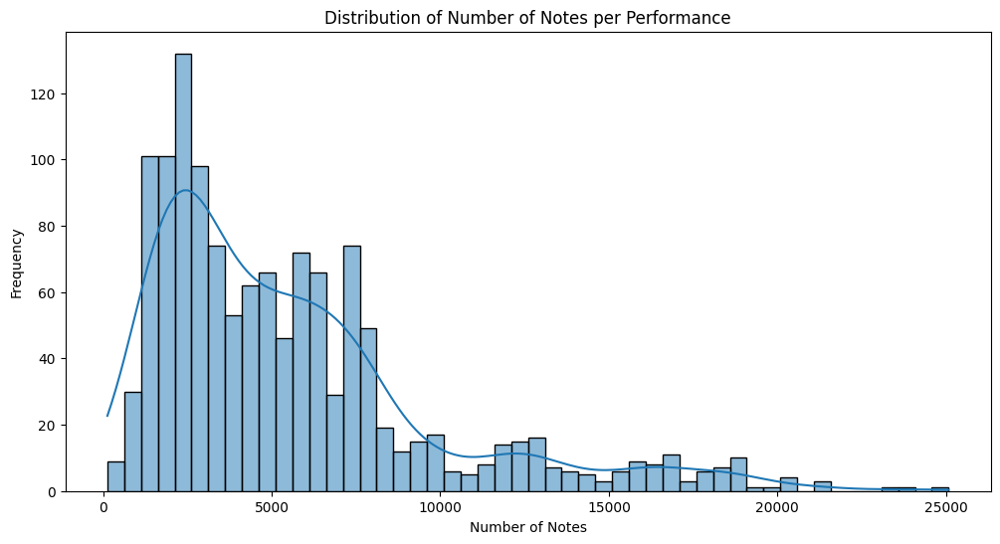

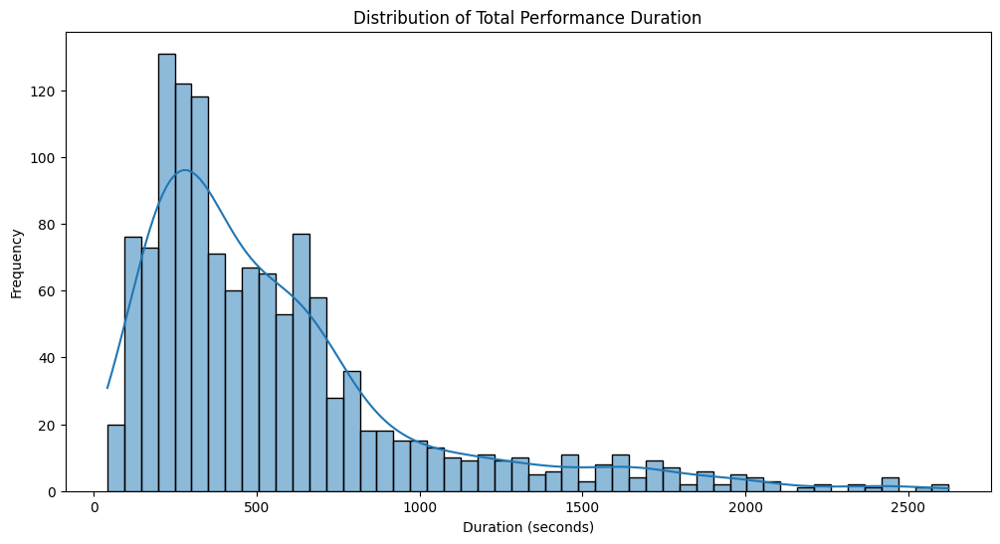

In [20]:
# Step 3: Analyze performance properties

# Number of notes per performance
num_notes_per_performance = [len(p) for split, performances in DATASET.items() for p in performances]
plt.figure(figsize=(12, 6))
sns.histplot(num_notes_per_performance, bins=50, kde=True)
plt.title('Distribution of Number of Notes per Performance')
plt.xlabel('Number of Notes')
plt.ylabel('Frequency')
plt.show()

# Total duration of performances
total_duration_per_performance = [p[-1][0] - p[0][0] if p else 0 for split, performances in DATASET.items() for p in performances]
plt.figure(figsize=(12, 6))
sns.histplot(total_duration_per_performance, bins=50, kde=True)
plt.title('Distribution of Total Performance Duration')
plt.xlabel('Duration (seconds)')
plt.ylabel('Frequency')
plt.show()

## Reintroducing Velocity to the autoencoder (NEW)

As noted in the original documentation, the original version of Piano Genie did not utilize velocity to make its predictions. Since we use the entire QWERTY keyboard for our project, we saw an opportunity to test if the model performance would differ by adding velocity to the autoencoder.

In the `PianoDecoder` class, we needed to reintroduce the velocity parameter initially dropped from the inputs, as shown below:

```python
inputs = [
            F.one_hot(k_m1, PIANO_NUM_KEYS + 1),
            t.unsqueeze(dim=2),
            b.unsqueeze(dim=2),
            v.unsqueeze(dim=2),
        ]
```

We also had to do a similar thing for the encoder, changing function signatures:

```python
def forward(self, k, t, v):
        inputs = [
            F.one_hot(k, PIANO_NUM_KEYS),
            t.unsqueeze(dim=2),
            v.unsqueeze(dim=2),
        ]
```

### Location in original docs mentioning lack of velocity:

```
we anticipate that it will be frustrating for users if the model predicts dynamics on their behalf, so we remove velocity terms  𝐯 :
```

In [21]:
# @title **(Step 2)** Define Piano Genie autoencoder

# @markdown Our intended interaction for Piano Genie is to have users perform on a miniature 8-button keyboard and automatically map each of their button presses to a key on a piano.
# @markdown Similarly to our formalization of piano performances, we will formalize a "button performance" as a sequence of "notes", where piano keys $k_i$ are replaced with buttons $b_i$, and we remove velocity since our button controller is not velocity sensitive.
# @markdown So a button performance $\mathbf{c}$ is:

# @markdown - $\mathbf{c} = (c_1, \ldots, c_N)$, where $c_i = (t_i, d_i, b_i \in \mathbb{B})$, i.e., (onsets, durations, buttons), and $\mathbb{B} = \{ \color{#EE2B29}\blacksquare, \color{#ff9800}\blacksquare, \color{#ffff00}\blacksquare, \color{#c6ff00}\blacksquare, \color{#00e5ff}\blacksquare, \color{#2979ff}\blacksquare, \color{#651fff}\blacksquare, \color{#d500f9}\blacksquare \}$

# @markdown And a corresponding piano performance is:

# @markdown - $\mathbf{x} = (x_1, \ldots, x_N)$, where $x_i = (t_i, d_i, k_i, v_i)$, i.e., (onsets, durations, keys, velocities)

# @markdown To map button performances into piano performances, we will train a generative model $P(\mathbf{x} \mid \mathbf{c})$.
# @markdown In practice, we will factorize this joint distribution over note sequences $\mathbf{x}$ into the product of conditional probabilities of individual notes: $P(\mathbf{x} \mid \mathbf{c}) = \prod_{i=1}^{N} P(x_i \mid \mathbf{x}_{< i}, \mathbf{c})$.

# @markdown Hence, our **overall goal is to learn** $P(x_i \mid \mathbf{x}_{< i}, \mathbf{c})$,
# @markdown which we will **approximate by modeling**:

# @markdown <center>$P(k_i \mid \mathbf{k}_{<i}, \mathbf{t}_{\leq i}, \mathbf{b}_{\leq i})$.</center>

# @markdown We arrived at this approximation by working through constraints imposed by the interaction (details at the end).

import torch
import torch.nn as nn
import torch.nn.functional as F

# @markdown #### **Decoder**

# @markdown <center><img src="https://raw.githubusercontent.com/chrisdonahue/music-cocreation-tutorial/main/part-1-py-training/figures/decoder.png" width=600px/></center>
# @markdown <center><b>Piano Genie decoder processing $N=4$ notes</b></center>

# @markdown The approximation $P(k_i \mid \mathbf{k}_{<i}, \mathbf{t}_{\leq i}, \mathbf{b}_{\leq i})$ constitutes the decoder of Piano Genie, which we will parameterize using an RNN.
# @markdown This is the portion of the model that users will interact with.
# @markdown To achieve our intended real-time interaction, we will compute and sample from this RNN at the instant the user presses a button, passing as input the key from the previous timestep, the current time, the button the user pressed, and a vector which summarizes the ongoing history.

# @markdown Formally, the decoder is a function:
# @markdown $D_{\theta}: k_{i-1}, t_i, b_i, \mathbf{h}_{i-1} \mapsto \mathbf{\hat{k}}_i, \mathbf{h}_i$, where:

# @markdown - $k_0$ is a special start-of-sequence token $<\text{S}>$

# @markdown - $\mathbf{h}_i$ is a vector summarizing timesteps $1, \ldots, i$

# @markdown - $\mathbf{h}_0$ is some initial value (zeros) for that vector

# @markdown - $\mathbf{\hat{k}}_i \in \mathbb{R}^{88}$ are the output logits for timestep $i$

SOS = PIANO_NUM_KEYS

class PianoGenieDecoder(nn.Module):
    def __init__(self, rnn_dim=128, rnn_num_layers=2):
        super().__init__()
        self.rnn_dim = rnn_dim
        self.rnn_num_layers = rnn_num_layers
        #change this to 4
        self.input = nn.Linear(PIANO_NUM_KEYS + 4, rnn_dim)
        self.lstm = nn.LSTM(
            rnn_dim,
            rnn_dim,
            rnn_num_layers,
            batch_first=True,
            bidirectional=False,
        )
        self.output = nn.Linear(rnn_dim, 88)

    def init_hidden(self, batch_size, device=None):
        h = torch.zeros(self.rnn_num_layers, batch_size, self.rnn_dim, device=device)
        c = torch.zeros(self.rnn_num_layers, batch_size, self.rnn_dim, device=device)
        return (h, c)

    def forward(self, k, t, b, v, h_0=None):
        # Prepend <S> token to shift k_i to k_{i-1}
        k_m1 = torch.cat([torch.full_like(k[:, :1], SOS), k[:, :-1]], dim=1)

        # Encode input
        inputs = [
            F.one_hot(k_m1, PIANO_NUM_KEYS + 1),
            t.unsqueeze(dim=2),
            b.unsqueeze(dim=2),
            v.unsqueeze(dim=2),
        ]
        x = torch.cat(inputs, dim=2)

        # Project encoded inputs
        x = self.input(x)

        # Run RNN
        if h_0 is None:
            h_0 = self.init_hidden(k.shape[0], device=k.device)
        x, h_N = self.lstm(x, h_0)

        # Compute logits
        hat_k = self.output(x)

        return hat_k, h_N


# @markdown #### **Encoder**

# @markdown <center><img src="https://i.imgur.com/P3bQFsC.png" width=600px/></center>
# @markdown <center><b>Piano Genie encoder processing $N=4$ notes</b></center>

# @markdown Because we lack examples of human button performances, we use an encoder to automatically learn to map piano performances into synthetic button performances.
# @markdown The encoder takes as input a sequence of keys and onset times and produces an equal-length sequence of buttons.
# @markdown Formally, the encoder is a function: $E_{\varphi} : \mathbf{k}, \mathbf{t} \mapsto \mathbf{b}$.

# @markdown Note the conceptual difference between the decoder and the encoder: the decoder process one sequence item at a time, while the encoder maps an entire input sequence to an output sequence.
# @markdown This is because the decoder (which we will use during inference) needs to process information as it becomes available in real time, whereas the encoder (which we only use during training) can observe the entire piano sequence before translating it into buttons.
# @markdown Despite this conceptual difference, in practice the encoder is also an RNN (though a bidirectional one) under the hood.

class PianoGenieEncoder(nn.Module):
    def __init__(self, rnn_dim=128, rnn_num_layers=2):
        super().__init__()
        self.rnn_dim = rnn_dim
        self.rnn_num_layers = rnn_num_layers
        self.input = nn.Linear(PIANO_NUM_KEYS + 2, rnn_dim)
        self.lstm = nn.LSTM(
            rnn_dim,
            rnn_dim,
            rnn_num_layers,
            batch_first=True,
            bidirectional=True,
        )
        self.output = nn.Linear(rnn_dim * 2, 1)

    def forward(self, k, t, v):
        inputs = [
            F.one_hot(k, PIANO_NUM_KEYS),
            t.unsqueeze(dim=2),
            v.unsqueeze(dim=2),
        ]
        x = self.input(torch.cat(inputs, dim=2))
        # NOTE: PyTorch uses zeros automatically if h is None
        x, _ = self.lstm(x, None)
        x = self.output(x)
        return x[:, :, 0]


# @markdown #### **Quantizing encoder output to discrete buttons**

# @markdown <center><img src="https://raw.githubusercontent.com/chrisdonahue/music-cocreation-tutorial/main/part-1-py-training/figures/quantization.png" width=600px/></center>
# @markdown <center><b>Quantizing continuous encoder output (grey line) to eight discrete values (colorful line segments)</b></center>

# @markdown You may have noticed in the code that the encoder outputs a real-valued scalar (let's call it $e_i \in \mathbb{R}$) at each timestep, but our goal is to output one of eight discrete buttons, i.e., $b_i \in \mathbb{B}$.
# @markdown To achieve this, we will quantize this real-valued scalar as the centroid of the nearest of eight bins between $[-1, 1]$ (see figure above):

# @markdown <center>$b_i = 2 \cdot \frac{\tilde{b}_i - 1}{B - 1} - 1$, where $\tilde{b}_i = \text{round} \left( 1 + (B - 1) \cdot \min \left( \max \left( \frac{e_i  + 1}{2}, 0 \right), 1 \right) \right)$</center>

class IntegerQuantizer(nn.Module):
    def __init__(self, num_bins):
        super().__init__()
        self.num_bins = num_bins

    def real_to_discrete(self, x, eps=1e-6):
        x = (x + 1) / 2
        x = torch.clamp(x, 0, 1)
        x *= self.num_bins - 1
        x = (torch.round(x) + eps).long()
        return x

    def discrete_to_real(self, x):
        x = x.float()
        x /= self.num_bins - 1
        x = (x * 2) - 1
        return x

    def forward(self, x):
        # Quantize and compute delta (used for straight-through estimator)
        with torch.no_grad():
            x_disc = self.real_to_discrete(x)
            x_quant = self.discrete_to_real(x_disc)
            x_quant_delta = x_quant - x

        # @markdown In the backwards pass, we will use the straight-through estimator (Bengio et al. 2013), i.e., pretend that this discretization did not happen when computing gradients.
        # Quantize w/ straight-through estimator
        x = x + x_quant_delta

        return x


# @markdown #### **Defining the autoencoder**

# @markdown Finally, the Piano Genie autoencoder is simply the composition of the encoder, quantizer, and decoder.

class PianoGenieAutoencoder(nn.Module):
    def __init__(self, cfg):
        super().__init__()
        self.enc = PianoGenieEncoder(
            rnn_dim=cfg["model_rnn_dim"],
            rnn_num_layers=cfg["model_rnn_num_layers"],
        )
        self.quant = IntegerQuantizer(cfg["num_buttons"])
        self.dec = PianoGenieDecoder(
            rnn_dim=cfg["model_rnn_dim"],
            rnn_num_layers=cfg["model_rnn_num_layers"],
        )

    def forward(self, k, t, v):
        e = self.enc(k, t, v)
        b = self.quant(e)
        hat_k, _ = self.dec(k, t, b, v)
        return hat_k, e


# @markdown #### **Approximating $P(x_i \mid \mathbf{x}_{< i}, \mathbf{c})$**

# @markdown This section walks through how we designed an approximation to $P(x_i \mid \mathbf{x}_{< i}, \mathbf{c})$ which would be appropriate for our intended interaction. You probably don't need to understand this, but some may find it helpful as an illustration of how to design a generative model around constraints imposed by interaction.

# @markdown First, we expand the terms, treating the onsets $\mathbf{t}$ and durations $\mathbf{d}$ as part of the button performance $\mathbf{c}$:

# @markdown <center>$P(x_i \mid \mathbf{x}_{< i}, \mathbf{c}) = P(k_i, v_i \mid \mathbf{k}_{<i}, \mathbf{v}_{<i}, \mathbf{t}, \mathbf{d}, \mathbf{b})$</center>

# @markdown Because we want this interaction to be real-time, we must remove any information that might not be available at time $t_i$ (the moment the user presses a button), which includes future onsets $\mathbf{t}_{>i}$, future buttons $\mathbf{b}_{>i}$, and all durations $\mathbf{d}$, since notes can be held indefinitely:

# @markdown <center>$\approx P(k_i, v_i \mid \mathbf{k}_{<i}, \mathbf{v}_{<i}, \mathbf{t}_{\leq i}, \mathbf{b}_{\leq i})$</center>

# @markdown Finally, we anticipate that it will be frustrating for users if the model predicts dynamics on their behalf, so we remove velocity terms $\mathbf{v}$:

# @markdown <center>$\approx P(k_i, \mid \mathbf{k}_{<i}, \mathbf{t}_{\leq i}, \mathbf{b}_{\leq i})$</center>

## (STEP 3) Modifying training pipeline (NEW)

After modifying the autoencoder, we needed to figure out a way in order to fix the function calls in the training pipeline so the encoder could properly receive the velocity values, and that we could properly interpret the new output.

We needed to add a new `batch_v` parameter. `batch_v` is a list that stores the velocity values for each note in a minibatch of piano performances. `n[3]` represents the velocity value in a note, which can be derived by looking at how the `download_and_parse_maestro` function structures the notes list.

In context, the changes described are below.

```python
        # Key features
        batch_k.append([n[2] for n in subsample])
        batch_v.append([n[3] for n in subsample])

        # Onset features
        # NOTE: For stability, we pass delta time to Piano Genie instead of time.
        t = np.diff([n[0] for n in subsample])
        t = np.concatenate([[1e8], t])
        t = np.clip(t, 0, CFG["data_delta_time_max"])
        batch_t.append(t)

    return (torch.tensor(batch_k).long(), torch.tensor(batch_t).float(), torch.tensor(batch_v).float())
```

In [23]:
'@title **(Step 3)** Train Piano Genie'

# @markdown *Note*: Check this box to log training curves to [Weights & Biases](https://wandb.ai/) (which will prompt you to log in).
USE_WANDB = False  # @param{type:"boolean"}

# @markdown Now that we've defined the autoencoder, we need to train it.
# @markdown We will train the entire autoencoder end-to-end to minimize the reconstruction loss of the decoder.

# @markdown <center>$\mathcal{L}_{\text{recons}} = \frac{1}{N} \sum_{i=1}^{N} \text{CrossEntropy}(\text{Softmax}(\mathbf{\hat{k}}_i), k_i)$</center>

# @markdown This loss alone does not encourage the encoder to produce button sequences with any particular structure, so the behavior of the decoder will likely be fairly unpredictable at interaction time.
# @markdown We think it might be intuitive to users if the decoder respected the _contour_ of their performance, i.e., if higher buttons produced higher notes and lower buttons produced lower notes.
# @markdown Hence, we include a loss term which encourages the encoder to produces button sequences which align with the contour of the piano key sequences.

# @markdown <center>$\mathcal{L}_{\text{contour}} = \frac{1}{N - 1} \sum_{i=2}^{N} \max (0, 1 - (k_i - k_{i-1}) \cdot (e_i - e_{i-1}))^2$</center>

# @markdown Finally, we find empirically that the encoder often outputs values outside of the $[-1, 1]$ range used for discretization.
# @markdown Hence, we add a loss term which explicitly encourages this behavior

# @markdown <center>$\mathcal{L}_{\text{margin}} = \frac{1}{N} \sum_{i=1}^{N} \max(0, |e_i| - 1)^2$</center>

# @markdown Thus, our final loss function is:
# @markdown <center>$\mathcal{L} = \mathcal{L}_{\text{recons}} + \mathcal{L}_{\text{contour}} + \mathcal{L}_{\text{margin}}$</center>


CFG = {
    "seed": 0,
    # Number of buttons in interface
    "num_buttons": 26,
    # Onset delta times will be clipped to this maximum
    "data_delta_time_max": 1.0,
    # Max time stretch for data augmentation (+- 5%)
    "data_augment_time_stretch_max": 0.05,
    # Max transposition for data augmentation (+- tritone)
    "data_augment_transpose_max": 6,
    # RNN dimensionality
    "model_rnn_dim": 128,
    # RNN num layers
    "model_rnn_num_layers": 2,
    # Training hyperparameters
    "batch_size": 32,
    "seq_len": 128,
    "lr": 3e-4,
    "loss_margin_multiplier": 1.0,
    "loss_contour_multiplier": 1.0,
    "summarize_frequency": 128,
    "eval_frequency": 128,
    "max_num_steps": 50000
}

import pathlib
import random

import numpy as np

if USE_WANDB:
    try:
        import wandb
    except ModuleNotFoundError:
        !!pip install wandb
        import wandb

# Init
run_dir = pathlib.Path("piano_genie")
run_dir.mkdir(exist_ok=True)
with open(pathlib.Path(run_dir, "cfg.json"), "w") as f:
    f.write(json.dumps(CFG, indent=2))
if USE_WANDB:
    wandb.init(project="music-cocreation-tutorial", config=CFG, reinit=True)

# Set seed
if CFG["seed"] is not None:
    random.seed(CFG["seed"])
    np.random.seed(CFG["seed"])
    torch.manual_seed(CFG["seed"])
    torch.cuda.manual_seed_all(CFG["seed"])

# Create model
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

if torch.backends.mps.is_available():
    print("MPS available")
    device = torch.device("mps")
    
model = PianoGenieAutoencoder(CFG)
model.train()
model.to(device)
print("-" * 80)
for n, p in model.named_parameters():
    print(f"{n}, {p.shape}")

# Create optimizer
optimizer = torch.optim.Adam(model.parameters(), lr=CFG["lr"])

# Subsamples performances to create a minibatch
def performances_to_batch(performances, device, train=True):
    batch_k = []
    batch_t = []
    batch_v = []
    for p in performances:
        # Subsample seq_len notes from performance
        assert len(p) >= CFG["seq_len"]
        if train:
            subsample_offset = random.randrange(0, len(p) - CFG["seq_len"])
        else:
            subsample_offset = 0
        subsample = p[subsample_offset : subsample_offset + CFG["seq_len"]]
        assert len(subsample) == CFG["seq_len"]

        # Data augmentation
        if train:
            stretch_factor = random.random() * CFG["data_augment_time_stretch_max"] * 2
            stretch_factor += 1 - CFG["data_augment_time_stretch_max"]
            transposition_factor = random.randint(
                -CFG["data_augment_transpose_max"], CFG["data_augment_transpose_max"]
            )
            subsample = [
                (
                    n[0] * stretch_factor,
                    n[1] * stretch_factor,
                    max(0, min(n[2] + transposition_factor, PIANO_NUM_KEYS - 1)),
                    n[3],
                )
                for n in subsample
            ]

        # Key features
        batch_k.append([n[2] for n in subsample])
        batch_v.append([n[3] for n in subsample])

        # Onset features
        # NOTE: For stability, we pass delta time to Piano Genie instead of time.
        t = np.diff([n[0] for n in subsample])
        t = np.concatenate([[1e8], t])
        t = np.clip(t, 0, CFG["data_delta_time_max"])
        batch_t.append(t)

    return (torch.tensor(batch_k).long(), torch.tensor(batch_t).float(), torch.tensor(batch_v).float())


# Train
step = 0
best_eval_loss = float("inf")
while CFG["max_num_steps"] is None or step < CFG["max_num_steps"]:
    if step % CFG["eval_frequency"] == 0:
        model.eval()

        with torch.no_grad():
            eval_losses_recons = []
            eval_violates_contour = []
            for i in range(0, len(DATASET["validation"]), CFG["batch_size"]):
                eval_batch = performances_to_batch(
                    DATASET["validation"][i : i + CFG["batch_size"]],
                    device,
                    train=False,
                )
                eval_k, eval_t, eval_v = tuple(t.to(device) for t in eval_batch)
                eval_hat_k, eval_e = model(eval_k, eval_t, eval_v)
                eval_b = model.quant.real_to_discrete(eval_e)
                eval_loss_recons = F.cross_entropy(
                    eval_hat_k.view(-1, PIANO_NUM_KEYS),
                    eval_k.view(-1),
                    reduction="none",
                )
                eval_violates = torch.logical_not(
                    torch.sign(torch.diff(eval_k, dim=1))
                    == torch.sign(torch.diff(eval_b, dim=1)),
                ).float()
                eval_violates_contour.extend(eval_violates.cpu().numpy().tolist())
                eval_losses_recons.extend(eval_loss_recons.cpu().numpy().tolist())

            eval_loss_recons = np.mean(eval_losses_recons)
            if eval_loss_recons < best_eval_loss:
                torch.save(model.state_dict(), pathlib.Path(run_dir, "model.pt"))
                best_eval_loss = eval_loss_recons

        eval_metrics = {
            "eval_loss_recons": eval_loss_recons,
            "eval_contour_violation_ratio": np.mean(eval_violates_contour),
        }
        if USE_WANDB:
            wandb.log(eval_metrics, step=step)
        print(step, "eval", eval_metrics)

        model.train()

    # Create minibatch
    batch = performances_to_batch(
        random.sample(DATASET["train"], CFG["batch_size"]), device, train=True
    )
    k, t, v = tuple(t.to(device) for t in batch)

    # Run model
    optimizer.zero_grad()
    k_hat, e = model(k, t, v)

    # Compute losses and update params
    loss_recons = F.cross_entropy(k_hat.view(-1, PIANO_NUM_KEYS), k.view(-1))
    loss_margin = torch.square(
        torch.maximum(torch.abs(e) - 1, torch.zeros_like(e))
    ).mean()
    loss_contour = torch.square(
        torch.maximum(
            1 - torch.diff(k, dim=1) * torch.diff(e, dim=1),
            torch.zeros_like(e[:, 1:]),
        )
    ).mean()
    loss = torch.zeros_like(loss_recons)
    loss += loss_recons
    if CFG["loss_margin_multiplier"] > 0:
        loss += CFG["loss_margin_multiplier"] * loss_margin
    if CFG["loss_contour_multiplier"] > 0:
        loss += CFG["loss_contour_multiplier"] * loss_contour
    loss.backward()
    optimizer.step()
    step += 1

    if step % CFG["summarize_frequency"] == 0:
        metrics = {
            "loss_recons": loss_recons.item(),
            "loss_margin": loss_margin.item(),
            "loss_contour": loss_contour.item(),
            "loss": loss.item(),
        }
        if USE_WANDB:
            wandb.log(metrics, step=step)
        print(step, "train", metrics)

# Download the trained model so we don't lose it!
# from google.colab import files

# files.download('piano_genie/model.pt')
# files.download('piano_genie/cfg.json')

--------------------------------------------------------------------------------
enc.input.weight, torch.Size([128, 90])
enc.input.bias, torch.Size([128])
enc.lstm.weight_ih_l0, torch.Size([512, 128])
enc.lstm.weight_hh_l0, torch.Size([512, 128])
enc.lstm.bias_ih_l0, torch.Size([512])
enc.lstm.bias_hh_l0, torch.Size([512])
enc.lstm.weight_ih_l0_reverse, torch.Size([512, 128])
enc.lstm.weight_hh_l0_reverse, torch.Size([512, 128])
enc.lstm.bias_ih_l0_reverse, torch.Size([512])
enc.lstm.bias_hh_l0_reverse, torch.Size([512])
enc.lstm.weight_ih_l1, torch.Size([512, 256])
enc.lstm.weight_hh_l1, torch.Size([512, 128])
enc.lstm.bias_ih_l1, torch.Size([512])
enc.lstm.bias_hh_l1, torch.Size([512])
enc.lstm.weight_ih_l1_reverse, torch.Size([512, 256])
enc.lstm.weight_hh_l1_reverse, torch.Size([512, 128])
enc.lstm.bias_ih_l1_reverse, torch.Size([512])
enc.lstm.bias_hh_l1_reverse, torch.Size([512])
enc.output.weight, torch.Size([1, 256])
enc.output.bias, torch.Size([1])
dec.input.weight, torch.Size

## Ignoring Step 4 and 5 (NEW)

We chose to ignore Step 4 and 5, as the old interface would not be compatible with a model that expects 26 bins.

After Step 5, we will describe our new pipeline for encoding what the user types and interpreting that output file.


In [ ]:
# # @title **(Step 4)** Port trained decoder parameters to Tensorflow.js format

# # @markdown In this step, we will use the TensorFlow.js Python library to export our model's parameters in a binary format, to be loaded later by the JavaScript client.

# !!pip install tensorflowjs

# from tensorflowjs.write_weights import write_weights

# # Load saved model dict
# d = torch.load("piano_genie/model.pt", map_location=torch.device("cpu"))
# d = {k: v.numpy() for k, v in d.items()}

# # Convert to tensorflow-js format
# pathlib.Path("piano_genie/dec_tfjs").mkdir(exist_ok=True)
# write_weights(
#     [[{"name": k, "data": v} for k, v in d.items() if k.startswith("dec")]],
#     "piano_genie/dec_tfjs",
# )

In [ ]:
# # @title **(Step 5)** Create test case to check correctness of JavaScript port

# # @markdown Finally, we will serialize a sequence of inputs to and outputs from our trained model to create a test case for our JavaScript reimplementation.
# # @markdown This is critically important—I have ported many models from Python to JavaScript and have yet to get it right on the first try.
# # @markdown Porting models from PyTorch to TensorFlow.js is additionally tricky because parameters of the same shape are often used differently by the two APIs.

# # Restore model from saved checkpoint
# device = torch.device("cpu")
# with open("piano_genie/cfg.json", "r") as f:
#     cfg = json.load(f)
# model = PianoGenieAutoencoder(cfg)
# model.load_state_dict(torch.load("piano_genie/model.pt", map_location=device))
# model.eval()
# model.to(device)

# # Serialize a batch of inputs/outputs as JSON
# with torch.no_grad():
#     ground_truth_keys, input_dts = performances_to_batch(
#         [DATASET["validation"][0]], device, train=False
#     )
#     output_logits, input_buttons = model(ground_truth_keys, input_dts)
#     input_buttons = model.quant.real_to_discrete(input_buttons)

#     input_dts = input_dts[0].cpu().numpy().tolist()
#     ground_truth_keys = ground_truth_keys[0].cpu().numpy().tolist()
#     input_keys = [PIANO_NUM_KEYS] + ground_truth_keys[:-1]
#     input_buttons = input_buttons[0].cpu().numpy().tolist()
#     output_logits = output_logits[0].cpu().numpy().tolist()

#     test = {
#         n: eval(n)
#         for n in ["input_dts", "input_keys", "input_buttons", "output_logits"]
#     }
#     with open(pathlib.Path("piano_genie", "test.json"), "w") as f:
#         f.write(json.dumps(test))

## New Step 4 and 5 (NEW)

### Taking User Input

We created a new HTML website that encodes user input as a CSV file. The file can be found on our Github here: https://github.com/AnniePhan02/CSE253-Assignment2/blob/main/task2/index.html

### Feeding user input file into the model

Running Steps 1-5 will result in two files: `cfg.json` and `model.pt`.

The key function to generate output from the model is the `step()` function.



Example `CFG.json`

```json
{
  "seed": 0,
  "num_buttons": 26,
  "data_delta_time_max": 1.0,
  "data_augment_time_stretch_max": 0.05,
  "data_augment_transpose_max": 6,
  "model_rnn_dim": 128,
  "model_rnn_num_layers": 2,
  "batch_size": 32,
  "seq_len": 128,
  "lr": 0.0003,
  "loss_margin_multiplier": 1.0,
  "loss_contour_multiplier": 1.0,
  "summarize_frequency": 128,
  "eval_frequency": 128,
  "max_num_steps": 50000
}
```

## Running the Newly Generated Model

The repository we pulled from had some base code for training the model, but not for running it. We created the following script with the assistance of copilot in order to feed input and interpret output from the model.

### Defining Bins Based On Keys

Since we have 26 keys, we made 26 bins

```python
def letter_to_button_26(letter):
    # Map letters to button indices for a 26-letter keyboard layout
    alphabet = "abcdefghijklmnopqrstuvwxyz"
    if letter in alphabet:
        return alphabet.index(letter)
    else:
        return 0  # Default case for unsupported characters

```

### Single Note Eval

In [58]:
import torch
import json

cfg = json.load(open("cfg.json"))
model = PianoGenieAutoencoder(cfg)
model.load_state_dict(torch.load("model.pt", map_location="cpu"))
model.eval()

# 2) Prepare decoder state for a single stream
#    We’ll run batch_size=1 since we’re in interactive mode
h = model.dec.init_hidden(batch_size=1)
# k_prev holds the last output key index; start with SOS
k_prev = torch.full((1, 1), SOS, dtype=torch.long)

# 3) Now, each time the user presses a button, you have:
#    b_i: integer 0…7    (which button)
#    t_i: float          (absolute onset time in seconds)
#    v_i: int 1…127      (velocity)
#
# You’ll convert these into tensors, call the decoder, sample/argmax,
# and then feed that key back in as the next k_prev.


def step(b_i, t_i, v_i, k_prev, h):
    # 3a) button needs to be the *real-valued* centroid in [–1,1]
    b_real = model.quant.discrete_to_real(torch.tensor([[b_i]]))  # → shape (1,1)
    # 3b) wrap time & velocity
    t = torch.tensor([[t_i]], dtype=torch.float)
    v = torch.tensor([[v_i]], dtype=torch.float)

    # 3c) run decoder for one timestep
    with torch.no_grad():
        logits, h = model.dec(k_prev, t, b_real, v, h)
        # logits: (1,1,88)
        probs = torch.softmax(logits[0, 0], dim=-1)
        k_i = torch.multinomial(probs, num_samples=1)  # or .argmax()

    return k_i.reshape(1, 1), h, probs


# 4) Example usage:
#    Suppose the user hits button 3 at time=0.57s with velocity=90:
# k1, h, p = step(b_i=3, t_i=0.57, v_i=90, k_prev=k_prev, h=h)


# version 1
def letter_to_button_keyboard(letter):
    # Map letters on the keyboard to button indices, top row, middle row, bottom row
    top = "qwertyuiop"
    middle = "asdfghjkl"
    bottom = "zxcvbnm"
    if letter in top:
        return min(top.index(letter), 8), 40
    elif letter in middle:
        return min(middle.index(letter), 8), 80
    elif letter in bottom:
        return min(bottom.index(letter), 8), 120
    else:
        return 0, 0


def letter_to_button_26(letter):
    # Map letters to button indices for a 26-letter keyboard layout
    alphabet = "abcdefghijklmnopqrstuvwxyz"
    if letter in alphabet:
        return alphabet.index(letter)
    else:
        return 0  # Default case for unsupported characters


# read typing_intervals.csv
import csv

# 4) Example usage:
#    Suppose the user hits button 3 at time=0.57s with velocity=90:
# k1, h, p = step(b_i=3, t_i=0.57, v_i=90, k_prev=k_prev, h=h)

notes = []

filename = "typing_wpm_timestamps.csv"
filename_no_ext = filename.split(".")[0]

# To generate `eval.txt`, run this cell and pipe output to a file

with open(filename, "r") as f:
    reader = csv.reader(f)
    # skip header
    next(reader)
    for row in reader:
        print(row)
        letter, time, wpm = row[0], row[1], row[2]

        if not letter or not time:
            print("Skipping empty row")
            continue

        # check if wpm is numeric
        if "Inf" in wpm:
            print(f"Skipping non-numeric wpm: {wpm}")
            continue

        time = float(time)
        wpm = float(wpm)

        print(letter, time, wpm)
        # convert letter to button index and velocity
        letter = letter.lower()

        # velocity is used from mapping function, mapping is based on keyboard layout
        button = letter_to_button_26(letter)
        velocity = int(wpm * 2)
        # ensure velocity is in range 1-127
        velocity = max(1, min(127, velocity))
        k_prev, h, probs = step(b_i=button, t_i=time, v_i=velocity, k_prev=k_prev, h=h)
        notes.append((button, k_prev.item(), time, velocity))
print(notes)
# generate the midi file
import pretty_midi
import time

pm = pretty_midi.PrettyMIDI()
instr = pretty_midi.Instrument(program=0)

for i, (button, note, onset, vel) in enumerate(notes):
    # define a duration for each note
    if i + 1 < len(notes):
        end = notes[i + 1][1]
    else:
        end = onset + 0.5
    pm_note = pretty_midi.Note(velocity=vel, pitch=note, start=onset, end=end)
    print(pm_note)
    instr.notes.append(pm_note)

pm.instruments.append(instr)
filename = f"output_{time.time()}_{filename_no_ext}.mid"
pm.write(filename) 


['I', '3.496', '10.3']
I 3.496 10.3
[' ', '3.622', '13.3']
  3.622 13.3
['w', '3.697', '16.2']
w 3.697 16.2
['Backspace', '3.957', '18.2']
Backspace 3.957 18.2
['a', '4.023', '20.9']
a 4.023 20.9
['m', '4.121', '23.3']
m 4.121 23.3
[' ', '4.229', '25.5']
  4.229 25.5
['g', '4.298', '27.9']
g 4.298 27.9
['o', '4.399', '30.0']
o 4.399 30.0
['i', '4.538', '31.7']
i 4.538 31.7
['n', '4.591', '34.0']
n 4.591 34.0
['g', '4.665', '36.0']
g 4.665 36.0
[' ', '4.731', '38.0']
  4.731 38.0
['t', '4.798', '40.0']
t 4.798 40.0
['o', '4.837', '42.2']
o 4.837 42.2
[' ', '4.923', '43.9']
  4.923 43.9
['p', '5.040', '45.2']
p 5.04 45.2
['a', '5.102', '47.0']
a 5.102 47.0
['s', '5.246', '48.0']
s 5.246 48.0
['s', '5.367', '49.2']
s 5.367 49.2
[' ', '5.460', '50.5']
  5.46 50.5
['Shift', '5.741', '50.2']
Shift 5.741 50.2
['C', '5.798', '51.7']
C 5.798 51.7
['S', '5.948', '52.5']
S 5.948 52.5
['E', '6.136', '52.8']
E 6.136 52.8
[' ', '6.335', '53.0']
  6.335 53.0
['2', '6.525', '53.3']
2 6.525 53.3
['1', 

### Eval.txt

The dropdown below shows that our 

<details>
  <summary>
    eval.txt
  </summary>
```
File: baseline_english_1_1748804204.7677963.mid
(4, 0.6468253968253969)
Key i:
  Pitches: 28

Key t:
  Pitches: 25

Key w:
  Pitches: 22

Key a:
  Pitches: 31

Key s:
  Pitches: 32

Key b:
  Pitches: 44

Key r:
  Pitches: 24

Key g:
  Pitches: 35

Key h:
  Pitches: 36

Key c:
  Pitches: 42

Key o:
  Pitches: 29

Key l:
  Pitches: 39

Key d:
  Pitches: 33

Key y:
  Pitches: 26

Key n:
  Pitches: 45

Key p:
  Pitches: 30

Key e:
  Pitches: 23

Key k:
  Pitches: 38

Key m:
  Pitches: 46

Key u:
  Pitches: 27

Key z:
  Pitches: 40

Key f:
  Pitches: 34

Key v:
  Pitches: 43

Key q:
  Pitches: 21

File: baseline_english_2_1748804270.5347235.mid
(0, 0.6462882096069869)
Key t:
  Pitches: 25

Key h:
  Pitches: 36

Key e:
  Pitches: 23

Key l:
  Pitches: 39

Key a:
  Pitches: 31

Key n:
  Pitches: 45

Key w:
  Pitches: 22

Key i:
  Pitches: 28

Key d:
  Pitches: 33

Key m:
  Pitches: 46

Key u:
  Pitches: 27

Key c:
  Pitches: 42

Key o:
  Pitches: 29

Key f:
  Pitches: 34

Key p:
  Pitches: 30

Key s:
  Pitches: 32

Key r:
  Pitches: 24

Key k:
  Pitches: 38

Key g:
  Pitches: 35

Key b:
  Pitches: 44

Key q:
  Pitches: 21

Key y:
  Pitches: 26

Key v:
  Pitches: 43

File: baseline_english_3_1748827500.4073334.mid
(0, 0.6820276497695853)
Key i:
  Pitches: 28

Key f:
  Pitches: 34

Key m:
  Pitches: 46

Key u:
  Pitches: 27

Key s:
  Pitches: 32

Key c:
  Pitches: 42

Key b:
  Pitches: 44

Key e:
  Pitches: 23

Key t:
  Pitches: 25

Key h:
  Pitches: 36

Key o:
  Pitches: 29

Key d:
  Pitches: 33

Key l:
  Pitches: 39

Key v:
  Pitches: 43

Key p:
  Pitches: 30

Key a:
  Pitches: 31

Key y:
  Pitches: 26

Key n:
  Pitches: 45

Key g:
  Pitches: 35

Key x:
  Pitches: 41

Key r:
  Pitches: 24

Key k:
  Pitches: 38

Key w:
  Pitches: 22

File: baseline_english_3_1748827756.1898053.mid
(0, 0.6820276497695853)
Key i:
  Pitches: 28

Key f:
  Pitches: 34

Key m:
  Pitches: 46

Key u:
  Pitches: 27

Key s:
  Pitches: 32

Key c:
  Pitches: 42

Key b:
  Pitches: 44

Key e:
  Pitches: 23

Key t:
  Pitches: 25

Key h:
  Pitches: 36

Key o:
  Pitches: 29

Key d:
  Pitches: 33

Key l:
  Pitches: 39

Key v:
  Pitches: 43

Key p:
  Pitches: 30

Key a:
  Pitches: 31

Key y:
  Pitches: 26

Key n:
  Pitches: 45

Key g:
  Pitches: 35

Key x:
  Pitches: 41

Key r:
  Pitches: 24

Key k:
  Pitches: 38

Key w:
  Pitches: 22

File: baseline_performance_1_1748805631.1922073.mid
(4, 0.6428571428571429)
Key a:
  Pitches: 31

Key d:
  Pitches: 33

Key g:
  Pitches: 35

Key s:
  Pitches: 32

Key p:
  Pitches: 30

Key o:
  Pitches: 29

Key f:
  Pitches: 34

File: baseline_performance_2_1748805691.4368095.mid
(5, 0.7096774193548387)
Key z:
  Pitches: 40

Key v:
  Pitches: 43

Key b:
  Pitches: 44

Key n:
  Pitches: 45

Key k:
  Pitches: 38

Key m:
  Pitches: 46

Key f:
  Pitches: 34

Key j:
  Pitches: 37

Key l:
  Pitches: 39

Key d:
  Pitches: 33

File: baseline_performance_3_1748827470.3868184.mid
(0, 0.7777777777777778)
Key q:
  Pitches: 21

Key z:
  Pitches: 40

Key x:
  Pitches: 41

Key v:
  Pitches: 43

Key c:
  Pitches: 42

Key n:
  Pitches: 45

File: output_english_1_1748804467.0220675.mid
(1, 0.6865079365079365)
Key i:
  Pitches: 42, 40, 41, 44, 45, 46, 47, 48

Key t:
  Pitches: 49, 48, 50, 51, 52, 53, 54, 57, 56

Key w:
  Pitches: 48, 51, 50, 56, 58, 60

Key a:
  Pitches: 30, 31, 32, 33, 37

Key s:
  Pitches: 47, 48, 49, 50, 51, 53, 55, 54, 58, 57

Key b:
  Pitches: 32, 33

Key r:
  Pitches: 46, 48, 47, 50, 49, 51, 52, 56

Key g:
  Pitches: 39, 40, 42, 43, 44, 45

Key h:
  Pitches: 41, 42, 44, 45, 47

Key c:
  Pitches: 36, 37, 38, 39

Key o:
  Pitches: 46, 47, 48, 50, 49, 51, 53, 55

Key l:
  Pitches: 43, 44, 45, 46, 47, 49, 51

Key d:
  Pitches: 37, 38, 39, 40

Key y:
  Pitches: 53, 57, 58, 61

Key n:
  Pitches: 45, 46, 47, 50, 49, 52, 53, 54

Key p:
  Pitches: 46, 48, 49, 53

Key e:
  Pitches: 39, 38, 40, 41, 44

Key k:
  Pitches: 44, 43, 45, 48

Key m:
  Pitches: 44, 47, 51

Key u:
  Pitches: 51, 53, 54, 56, 58

Key z:
  Pitches: 54, 56

Key f:
  Pitches: 40, 39, 41, 44

Key v:
  Pitches: 54, 56, 57

Key q:
  Pitches: 51, 54

File: output_english_1_1748804472.0935662.mid
(1, 0.6904761904761905)
Key i:
  Pitches: 43, 40, 41, 42, 44, 45, 46, 47, 48

Key t:
  Pitches: 48, 50, 49, 51, 53, 54, 56, 57, 58

Key w:
  Pitches: 48, 51, 57, 58, 61

Key a:
  Pitches: 31, 30, 32, 33, 36, 37

Key s:
  Pitches: 47, 48, 49, 50, 53, 55, 52, 54, 56, 57

Key b:
  Pitches: 33, 32

Key r:
  Pitches: 46, 48, 47, 49, 51, 52, 53, 55, 56, 57

Key g:
  Pitches: 39, 40, 42, 44, 45, 46

Key h:
  Pitches: 40, 41, 44, 45, 46, 48

Key c:
  Pitches: 35, 36, 37, 38, 40

Key o:
  Pitches: 46, 47, 49, 51, 48, 50, 52, 53, 54, 55

Key l:
  Pitches: 43, 44, 46, 47, 49, 51

Key d:
  Pitches: 37, 38, 39, 40

Key y:
  Pitches: 54, 57, 58, 61

Key n:
  Pitches: 45, 46, 47, 50, 49, 51, 53, 54

Key p:
  Pitches: 47, 48, 49, 54

Key e:
  Pitches: 38, 39, 40, 41, 44

Key k:
  Pitches: 44, 43, 45, 47

Key m:
  Pitches: 45, 47, 51

Key u:
  Pitches: 51, 54, 56, 58

Key z:
  Pitches: 54, 56

Key f:
  Pitches: 40, 39, 41, 44

Key v:
  Pitches: 55, 57, 58

Key q:
  Pitches: 51, 54

File: output_english_1_1748804484.7478225.mid
(3, 0.6865079365079365)
Key i:
  Pitches: 43, 40, 41, 42, 44, 45, 46, 47, 48

Key t:
  Pitches: 48, 50, 49, 51, 52, 53, 54, 56, 57, 58

Key w:
  Pitches: 48, 51, 56, 58

Key a:
  Pitches: 31, 34, 32, 33, 30, 36

Key s:
  Pitches: 47, 48, 49, 50, 51, 53, 55, 54, 56, 57

Key b:
  Pitches: 32, 33

Key r:
  Pitches: 46, 47, 48, 50, 52, 53, 55, 56

Key g:
  Pitches: 39, 40, 42, 44, 45

Key h:
  Pitches: 40, 41, 42, 44, 45, 46, 47

Key c:
  Pitches: 34, 36, 37, 32, 38, 39

Key o:
  Pitches: 46, 47, 49, 50, 51, 52, 53, 55, 54

Key l:
  Pitches: 44, 46, 45, 47, 49, 51

Key d:
  Pitches: 37, 38, 39, 40

Key y:
  Pitches: 53, 57, 58, 59

Key n:
  Pitches: 45, 46, 47, 50, 49, 51, 53, 54

Key p:
  Pitches: 46, 48, 49, 54

Key e:
  Pitches: 39, 38, 41, 40, 42, 44

Key k:
  Pitches: 44, 43, 45, 47

Key m:
  Pitches: 44, 48, 53

Key u:
  Pitches: 51, 54, 56, 57, 58

Key z:
  Pitches: 55, 56

Key f:
  Pitches: 40, 39, 41, 44

Key v:
  Pitches: 55, 57, 58

Key q:
  Pitches: 50, 54

File: output_english_2_1748804434.1069958.mid
(1, 0.6812227074235808)
Key t:
  Pitches: 54, 49, 50, 51, 53, 56, 57, 58

Key h:
  Pitches: 39, 41, 40, 42, 43, 44, 45, 46

Key e:
  Pitches: 37, 38, 39, 40, 41, 43, 42

Key l:
  Pitches: 43, 44, 45, 46, 47

Key a:
  Pitches: 31, 32, 33, 30, 29, 37

Key n:
  Pitches: 45, 44, 46, 47, 48, 50

Key w:
  Pitches: 51, 52, 53, 56, 57

Key i:
  Pitches: 41, 43, 44, 47

Key d:
  Pitches: 37, 38, 39, 40, 41

Key m:
  Pitches: 45

Key u:
  Pitches: 50, 51, 53, 56, 57

Key c:
  Pitches: 37, 36, 38

Key o:
  Pitches: 46, 48, 49, 50, 51, 53, 54

Key f:
  Pitches: 39, 44

Key p:
  Pitches: 46, 47

Key s:
  Pitches: 48, 49, 50, 54, 56

Key r:
  Pitches: 49, 47, 51, 54, 55

Key k:
  Pitches: 44, 45

Key g:
  Pitches: 41, 44, 45

Key b:
  Pitches: 34, 33, 36, 32, 37, 39

Key q:
  Pitches: 49

Key y:
  Pitches: 56, 57, 70, 61, 62

Key v:
  Pitches: 57

File: output_english_2_1748804446.052948.mid
(3, 0.6899563318777293)
Key t:
  Pitches: 54, 49, 50, 53, 55, 56, 57

Key h:
  Pitches: 39, 41, 40, 42, 43, 44, 45, 46

Key e:
  Pitches: 38, 37, 39, 40, 41, 42, 44

Key l:
  Pitches: 43, 44, 45, 47

Key a:
  Pitches: 31, 32, 33, 30, 29, 38

Key n:
  Pitches: 45, 44, 46, 47, 48, 50

Key w:
  Pitches: 51, 52, 53, 56, 55, 57

Key i:
  Pitches: 41, 43, 44, 47, 48

Key d:
  Pitches: 37, 38, 39, 40

Key m:
  Pitches: 44, 45

Key u:
  Pitches: 50, 51, 53, 56, 58

Key c:
  Pitches: 37, 36, 38

Key o:
  Pitches: 46, 48, 49, 50, 51, 52, 53, 54, 55

Key f:
  Pitches: 39, 44

Key p:
  Pitches: 46, 47

Key s:
  Pitches: 48, 49, 50, 54, 55, 56

Key r:
  Pitches: 48, 49, 52, 51, 55, 54

Key k:
  Pitches: 44, 46

Key g:
  Pitches: 41, 44

Key b:
  Pitches: 33, 36, 35, 37, 38, 39

Key q:
  Pitches: 50

Key y:
  Pitches: 56, 58, 61

Key v:
  Pitches: 57

File: output_english_3_1748804822.122112.mid
(3, 0.728110599078341)
Key i:
  Pitches: 39, 41, 43, 44, 46, 47

Key f:
  Pitches: 38, 39, 41, 44

Key m:
  Pitches: 44, 45, 48, 47, 55

Key u:
  Pitches: 48, 49, 56, 57, 58

Key s:
  Pitches: 47, 48, 50, 56, 55, 57, 58

Key c:
  Pitches: 36, 34

Key b:
  Pitches: 34, 32, 38

Key e:
  Pitches: 38, 39, 40, 41, 42, 43, 44

Key t:
  Pitches: 49, 48, 50, 51, 53, 54, 55, 56, 58

Key h:
  Pitches: 40, 41, 43, 44, 45, 49

Key o:
  Pitches: 46, 45, 48, 50, 51, 53, 52, 54, 55, 56

Key d:
  Pitches: 37, 38, 39, 40, 41, 42

Key l:
  Pitches: 44, 46, 47, 49, 51

Key v:
  Pitches: 51, 58

Key p:
  Pitches: 46, 54

Key a:
  Pitches: 31, 32, 33, 30, 36, 37

Key y:
  Pitches: 53, 57, 58

Key n:
  Pitches: 45, 46, 47, 49, 51, 53, 54, 55

Key g:
  Pitches: 39, 40, 41, 42, 45, 46

Key x:
  Pitches: 53

Key r:
  Pitches: 47, 49, 54, 55, 56, 57, 58

Key k:
  Pitches: 44, 46, 48

Key w:
  Pitches: 57

File: output_english_3_1748804834.8243206.mid
(3, 0.7235023041474654)
Key i:
  Pitches: 39, 41, 42, 43, 44, 46, 47

Key f:
  Pitches: 38, 39, 40, 44

Key m:
  Pitches: 44, 45, 48, 47, 55

Key u:
  Pitches: 48, 49, 56, 57, 58

Key s:
  Pitches: 48, 47, 50, 56, 57

Key c:
  Pitches: 36, 34

Key b:
  Pitches: 34, 32, 38

Key e:
  Pitches: 38, 39, 40, 41, 42, 43, 44, 45

Key t:
  Pitches: 49, 48, 50, 51, 53, 54, 56, 57, 58

Key h:
  Pitches: 41, 43, 44, 45, 47

Key o:
  Pitches: 46, 45, 48, 50, 53, 54, 55, 56

Key d:
  Pitches: 37, 38, 39, 40, 42, 43

Key l:
  Pitches: 44, 47, 46, 50, 51

Key v:
  Pitches: 51, 58

Key p:
  Pitches: 46, 55

Key a:
  Pitches: 32, 33, 31, 30, 36

Key y:
  Pitches: 53, 57, 58

Key n:
  Pitches: 45, 46, 47, 48, 50, 51, 53, 54, 56, 55

Key g:
  Pitches: 39, 41, 42, 45

Key x:
  Pitches: 53

Key r:
  Pitches: 47, 49, 53, 55, 56, 57, 58

Key k:
  Pitches: 44, 46, 48

Key w:
  Pitches: 58

File: output_performance_1_1748805169.7088091.mid
(1, 0.7380952380952381)
Key a:
  Pitches: 18, 31, 30, 32

Key d:
  Pitches: 35, 34, 37, 36

Key g:
  Pitches: 38, 39

Key s:
  Pitches: 46, 48, 47, 49

Key p:
  Pitches: 45, 46, 47

Key o:
  Pitches: 44

Key f:
  Pitches: 39

File: output_performance_1_1748805218.55786.mid
(6, 0.6904761904761905)
Key a:
  Pitches: 22, 30, 31

Key d:
  Pitches: 35, 37, 36

Key g:
  Pitches: 38

Key s:
  Pitches: 46, 45, 48, 47, 49

Key p:
  Pitches: 45, 44, 46

Key o:
  Pitches: 44

Key f:
  Pitches: 38, 39

File: output_performance_2_1748805761.0151947.mid
(3, 0.7419354838709677)
Key z:
  Pitches: 70, 50, 53

Key v:
  Pitches: 51, 48

Key b:
  Pitches: 32, 33

Key n:
  Pitches: 44, 43, 45

Key k:
  Pitches: 41

Key m:
  Pitches: 43, 44

Key f:
  Pitches: 38

Key j:
  Pitches: 41

Key l:
  Pitches: 43, 45

Key d:
  Pitches: 37

File: output_performance_2_1748805798.0441349.mid
(3, 0.7741935483870968)
Key z:
  Pitches: 70, 51, 53

Key v:
  Pitches: 51, 48

Key b:
  Pitches: 32, 33

Key n:
  Pitches: 44, 43, 45

Key k:
  Pitches: 41

Key m:
  Pitches: 43, 44

Key f:
  Pitches: 38

Key j:
  Pitches: 41

Key l:
  Pitches: 43, 44

Key d:
  Pitches: 37

File: output_performance_2_1748805941.4645994.mid
(3, 0.8064516129032258)
Key z:
  Pitches: 80, 50, 53

Key v:
  Pitches: 51, 48

Key b:
  Pitches: 32

Key n:
  Pitches: 44, 43, 45

Key k:
  Pitches: 41

Key m:
  Pitches: 43, 44, 45

Key f:
  Pitches: 38

Key j:
  Pitches: 41

Key l:
  Pitches: 43, 44

Key d:
  Pitches: 36

File: output_performance_3_1748805951.9792469.mid
(4, 0.7777777777777778)
Key q:
  Pitches: 53

Key z:
  Pitches: 54

Key x:
  Pitches: 49, 48

Key v:
  Pitches: 47, 48

Key c:
  Pitches: 32, 33

Key n:
  Pitches: 43, 44

File: output_performance_3_1748805957.8815727.mid
(4, 0.7777777777777778)
Key q:
  Pitches: 54

Key z:
  Pitches: 55

Key x:
  Pitches: 49, 48

Key v:
  Pitches: 47

Key c:
  Pitches: 33, 34, 32

Key n:
  Pitches: 43, 44

  </details>


Below, you can see that clicking a bin results in different notes with multiple clicks.

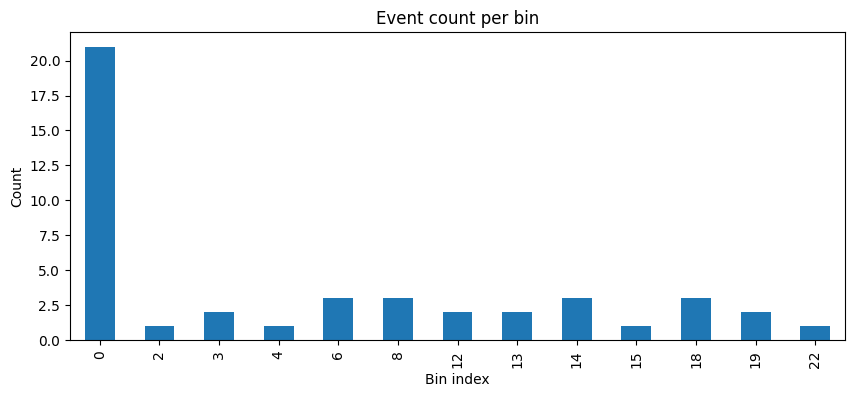

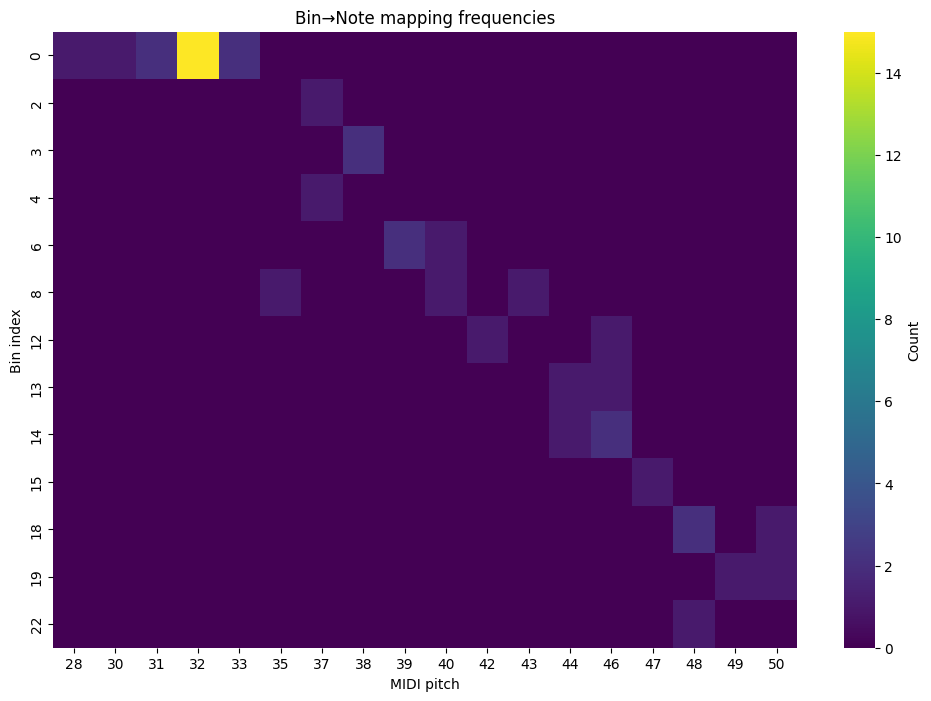

In [59]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# notes now should be list of tuples (bin, note, time, velocity)
df = pd.DataFrame(notes, columns=['bin','note','time','velocity'])

# 1) Bar chart: number of events per bin
plt.figure(figsize=(10,4))
df['bin'].value_counts().sort_index().plot(kind='bar', color='C0')
plt.xlabel('Bin index')
plt.ylabel('Count')
plt.title('Event count per bin')
plt.show()

# 2) Heatmap: bin × note frequency
pivot = df.groupby(['bin','note']).size().unstack(fill_value=0)
plt.figure(figsize=(12,8))
sns.heatmap(pivot, cmap='viridis', cbar_kws={'label':'Count'})
plt.xlabel('MIDI pitch')
plt.ylabel('Bin index')
plt.title('Bin→Note mapping frequencies')
plt.show()
# --- end diagnostics ---

In [ ]:
import torch
import json

# generate the midi file
import pretty_midi
import time as time_lib
import csv


cfg = json.load(open("cfg.json"))
model = PianoGenieAutoencoder(cfg)
model.load_state_dict(torch.load("model.pt", map_location="cpu"))
model.eval()

# 2) Prepare decoder state for a single stream
#    We’ll run batch_size=1 since we’re in interactive mode
h = model.dec.init_hidden(batch_size=1)
# k_prev holds the last output key index; start with SOS
k_prev = torch.full((1, 1), SOS, dtype=torch.long)

# 3) Now, each time the user presses a button, you have:
#    b_i: integer 0…7    (which button)
#    t_i: float          (absolute onset time in seconds)
#    v_i: int 1…127      (velocity)
#
# You’ll convert these into tensors, call the decoder, sample/argmax,
# and then feed that key back in as the next k_prev.


def step(b_i, t_i, v_i, k_prev, h):
    # 3a) button needs to be the *real-valued* centroid in [–1,1]
    b_real = model.quant.discrete_to_real(torch.tensor([[b_i]]))  # → shape (1,1)
    # 3b) wrap time & velocity
    t = torch.tensor([[t_i]], dtype=torch.float)
    v = torch.tensor([[v_i]], dtype=torch.float)

    # 3c) run decoder for one timestep
    with torch.no_grad():
        logits, h = model.dec(k_prev, t, b_real, v, h)
        # logits: (1,1,88)
        probs = torch.softmax(logits[0, 0], dim=-1)
        k_i = torch.multinomial(probs, num_samples=1)  # or .argmax()

    return k_i.reshape(1, 1), h, probs


# 4) Example usage:
#    Suppose the user hits button 3 at time=0.57s with velocity=90:
# k1, h, p = step(b_i=3, t_i=0.57, v_i=90, k_prev=k_prev, h=h)


# version 1
def letter_to_button_keyboard(letter):
    # Map letters on the keyboard to button indices, top row, middle row, bottom row
    top = "qwertyuiop"
    middle = "asdfghjkl"
    bottom = "zxcvbnm"
    if letter in top:
        return min(top.index(letter), 8), 40
    elif letter in middle:
        return min(middle.index(letter), 8), 80
    elif letter in bottom:
        return min(bottom.index(letter), 8), 120
    else:
        return 0, 0


# V2
def letter_to_button_26(letter):
    # Map letters to button indices for a 26-letter keyboard layout
    alphabet = "abcdefghijklmnopqrstuvwxyz"
    if letter in alphabet:
        return alphabet.index(letter)
    else:
        return 0  # Default case for unsupported characters


def letter_to_button_26_rowwise(letter):
    # Map letters to button indices for a 26-letter keyboard layout, row-wise
    alphabet = "qwertyuiopasdfghjklzxcvbnm"
    if letter in alphabet:
        return alphabet.index(letter)
    else:
        return 0  # Default case for unsupported characters


def extract_pitches_from_midi(midi_path):
    """
    Load a MIDI file and return a list of all note pitches (as MIDI numbers).
    """
    pm = pretty_midi.PrettyMIDI(midi_path)
    pitches = []

    # Loop over all instruments (tracks) in the file
    for instrument in pm.instruments:
        # Skip drum tracks if you only care about pitched notes:
        if instrument.is_drum:
            continue
        # Loop over each Note object in this instrument
        for note in instrument.notes:
            pitches.append(note.pitch)
    return pitches


# metric one
def infer_key_from_pitches(pitches):
    """
    Given a list of MIDI pitches (0–127), figure out which major key
    (0=C major, 1=C♯ major, …, 11=B major) has the most pitches landing
    on its diatonic pitch-classes.

    Returns (best_key_root, is_major=True).
    """
    # Define diatonic sets for all 12 major keys:
    # pitch-class → integer 0…11 where C=0, C♯=1, …, B=11
    major_scales = {
        0: {0, 2, 4, 5, 7, 9, 11},  # C major
        1: {1, 3, 5, 6, 8, 10, 0},  # C♯ major
        2: {2, 4, 6, 7, 9, 11, 1},  # D major
        3: {3, 5, 7, 8, 10, 0, 2},  # E♭/D♯ major
        4: {4, 6, 8, 9, 11, 1, 3},  # E major
        5: {5, 7, 9, 10, 0, 2, 4},  # F major
        6: {6, 8, 10, 11, 1, 3, 5},  # F♯ major
        7: {7, 9, 11, 0, 2, 4, 6},  # G major
        8: {8, 10, 0, 1, 3, 5, 7},  # A♭ major
        9: {9, 11, 1, 2, 4, 6, 8},  # A major
        10: {10, 0, 2, 3, 5, 7, 9},  # B♭ major
        11: {11, 1, 3, 4, 6, 8, 10},  # B major
    }

    # Build a histogram of pitch-classes
    pc_counts = [0] * 12
    for p in pitches:
        pc = p % 12
        pc_counts[pc] += 1

    # For each major key, count how many pitches are in its diatonic set
    best_key, best_count = None, -1
    for key_root, scale_set in major_scales.items():
        count_in_scale = sum(pc_counts[pc] for pc in scale_set)
        if count_in_scale > best_count:
            best_key, best_count = key_root, count_in_scale

    return best_key  # integer 0…11 (C major=0, C♯ major=1, etc.)


def compute_in_scale_ratio(notes, key_root=None):
    """
    notes: list of (midi_pitch, onset_time, velocity)
    key_root: if you already know the key (0…11), pass it in;
              otherwise, set key_root=None to auto-infer.
    Returns: (key_root, in_scale_ratio)
    """
    # 1) Extract just the pitches
    pitches = [p for p in notes]
    if key_root is None:
        key_root = infer_key_from_pitches(pitches)

    # 2) Get diatonic set for that key
    #    (using the same major_scales dict from above)
    major_scales = {
        0: {0, 2, 4, 5, 7, 9, 11},
        1: {1, 3, 5, 6, 8, 10, 0},
        2: {2, 4, 6, 7, 9, 11, 1},
        3: {3, 5, 7, 8, 10, 0, 2},
        4: {4, 6, 8, 9, 11, 1, 3},
        5: {5, 7, 9, 10, 0, 2, 4},
        6: {6, 8, 10, 11, 1, 3, 5},
        7: {7, 9, 11, 0, 2, 4, 6},
        8: {8, 10, 0, 1, 3, 5, 7},
        9: {9, 11, 1, 2, 4, 6, 8},
        10: {10, 0, 2, 3, 5, 7, 9},
        11: {11, 1, 3, 4, 6, 8, 10},
    }
    scale_set = major_scales[key_root]

    # 3) Count how many pitches lie in that set
    in_scale = sum(1 for p in pitches if (p % 12) in scale_set)
    total = len(pitches)
    ratio = in_scale / total if total > 0 else 0.0

    return key_root, ratio


def eval_map_key_to_pitches(pitches, filename):

    filename_no_ext = filename.split(".")[0]

    letters = []

    with open(filename, "r") as f:
        # print(f"Reading {filename} for letter-to-pitch mapping...")
        reader = csv.reader(f)
        # skip header
        next(reader)
        for row in reader:
            # print(row)
            letter, time, wpm = row[0], row[1], row[2]

            if not letter or not time or len(letter) != 1 or not letter.isalpha():
                # print("Skipping empty row")
                continue

            if wpm == "Infinity" or wpm == "inf":
                wpm = 80

            # check if wpm is numeric
            # if not wpm.isnumeric():
            #     print(f"Skipping non-numeric wpm: {wpm}")
            #     continue

            time = float(time)
            wpm = float(wpm)
            letter = letter.lower()

            letters.append(letter)

    letter_to_pitch_counts = {}

    if len(letters) != len(pitches):
        raise ValueError(
            f"Mismatch: {len(letters)} letters from CSV but {len(pitches)} notes provided."
        )

    for letter, pitch in zip(letters, pitches):
        # Ensure there’s a sub-dictionary for this letter
        if letter not in letter_to_pitch_counts:
            letter_to_pitch_counts[letter] = {}

        # Increment the count for this pitch under that letter
        subdict = letter_to_pitch_counts[letter]
        subdict[pitch] = subdict.get(pitch, 0) + 1

    return letter_to_pitch_counts


def baseline(filename):
    notes = []

    filename_no_ext = filename.split(".")[0]

    with open(filename, "r") as f:
        reader = csv.reader(f)
        # skip header
        next(reader)
        for row in reader:
            print(row)
            letter, time, wpm = row[0], row[1], row[2]

            if not letter or not time or len(letter) != 1 or not letter.isalpha():
                # print("Skipping empty row")
                continue

            if wpm == "Infinity" or wpm == "inf":
                wpm = 80

            # check if wpm is numeric
            # if not wpm.isnumeric():
            #     print(f"Skipping non-numeric wpm: {wpm}")
            #     continue

            time = float(time)
            wpm = float(wpm)

            print(letter, time, wpm)
            # convert letter to button index and velocity
            letter = letter.lower()

            # velocity is used from mapping function, mapping is based on keyboard layout
            button = letter_to_button_26_rowwise(letter)
            velocity = int(wpm) * 2
            # ensure velocity is in range 1-127
            velocity = max(1, min(127, velocity))

            # do a naive mapping of button to key index, without using step
            key_to_add = (
                button + 21
            )  # C4 is MIDI note 60, so we offset by 21 to get the right range
            notes.append((key_to_add, time, velocity))
    return notes


# read typing_intervals.csv


# 4) Example usage:
#    Suppose the user hits button 3 at time=0.57s with velocity=90:
# k1, h, p = step(b_i=3, t_i=0.57, v_i=90, k_prev=k_prev, h=h)


# generate midi from timestamps
notes = []

filename = "english_3.csv"
filename_no_ext = filename.split(".")[0]

with open(filename, "r") as f:
    reader = csv.reader(f)
    # skip header
    next(reader)
    for row in reader:
        print(row)
        letter, time, wpm = row[0], row[1], row[2]

        if not letter or not time or len(letter) != 1 or not letter.isalpha():
            # print("Skipping empty row")
            continue

        if wpm == "Infinity" or wpm == "inf":
            wpm = 80

        # check if wpm is numeric
        # if not wpm.isnumeric():
        #     print(f"Skipping non-numeric wpm: {wpm}")
        #     continue

        time = float(time)
        wpm = float(wpm)

        print(letter, time, wpm)
        # convert letter to button index and velocity
        letter = letter.lower()

        # velocity is used from mapping function, mapping is based on keyboard layout
        button = letter_to_button_26(letter)
        velocity = int(wpm) * 2
        # ensure velocity is in range 1-127
        velocity = max(1, min(127, velocity))
        k_prev, h, probs = step(b_i=button, t_i=time, v_i=velocity, k_prev=k_prev, h=h)
        notes.append((k_prev.item(), time, velocity))
print(notes)


# use baseline

use_baseline = True

if use_baseline:
    notes = baseline(filename)

pm = pretty_midi.PrettyMIDI()
instr = pretty_midi.Instrument(program=0)

for i, (note, onset, vel) in enumerate(notes):
    # define a duration for each note
    if i + 1 < len(notes):
        end = notes[i + 1][1]
    else:
        end = onset + 0.5
    pm_note = pretty_midi.Note(velocity=vel, pitch=note, start=onset, end=end)
    print(pm_note)
    instr.notes.append(pm_note)

pm.instruments.append(instr)
filename = f"output_{filename_no_ext}_{time_lib.time()}.mid"

if use_baseline:
    filename = f"baseline_{filename_no_ext}_{time_lib.time()}.mid"
pm.write(filename)


# run evals
import glob

# Look for files ending in .mid or .midi in the current directory
midi_patterns = ["*.mid", "*.midi"]
all_files = []
for pattern in midi_patterns:
    all_files.extend(glob.glob(pattern))

if not all_files:
    print("No MIDI files found in the current directory.")


# For each MIDI file, extract pitches and print a summary
for midi_file in sorted(all_files):
    pitches = []
    try:
        pitches = extract_pitches_from_midi(midi_file)
    except Exception as e:
        print(f"Error reading {midi_file}: {e}")
        continue
    print(f"File: {midi_file}")
    print(compute_in_scale_ratio(pitches))

    input_name = ""
    if "performance_1" in midi_file:
        input_name = "performance_1.csv"
    elif "performance_2" in midi_file:
        input_name = "performance_2.csv"
    elif "performance_3" in midi_file:
        input_name = "performance_3.csv"
    elif "english_1" in midi_file:
        input_name = "english_1.csv"
    elif "english_2" in midi_file:
        input_name = "english_2.csv"
    elif "english_3" in midi_file:
        input_name = "english_3.csv"

    key_to_pitches = eval_map_key_to_pitches(pitches, input_name)

    for key, pitches in key_to_pitches.items():
        print(f"Key {key}:")
        print("  Pitches:", ", ".join(str(p) for p in pitches))
        print()
